In [85]:
### automatically refresh the buffer

%load_ext autoreload
%autoreload 2

### solve the auto-complete issue

%config Completer.use_jedi = False

### lvl 1 setups

import sys
sys.path.append('/portal1/dell/GitHub/WAYS')
sys.path.append('/portal1/dell/GitHub/sanctuary')

%matplotlib inline

import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter(action='ignore', category=FutureWarning)

### lvl 2 setups (systerm)

import os
import numpy as np
import pandas as pd
import xarray as xr

import matplotlib as mpl
import matplotlib.pyplot as plt
from statsmodels.distributions.empirical_distribution import ECDF
from numpy import hstack
from matplotlib import pyplot
import cartopy.feature as cfeature
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
import warnings
warnings.filterwarnings('ignore')

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [86]:
from numpy import polyfit, poly1d
from stats import cr
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import linregress

In [87]:
import os
import glob
import numpy as np
import xarray as xr
import pandas as pd
import matplotlib as mpl
from matplotlib import cm
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap

from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
from stats import cr
from gistool import basemap, stack_image, stack_shp, stack_hatch, stack_shp_cn, ncslice
from spatial import upscale
import statsmodels.formula.api as smf
from scipy.stats.mstats import theilslopes
from scipy.stats import kendalltau
import cartopy.crs as ccrs

import pandas as pd
import scipy.stats as scs
import matplotlib.pyplot as plt

import climate_indices as indices
from climate_indices import compute
from climate_indices import utils, indices

In [88]:
from pylab import *
from matplotlib.colors import ListedColormap,LinearSegmentedColormap
clist1 =['#ffffff','#f8ad9d','#3a20f0']
red1 = LinearSegmentedColormap.from_list('chaos',clist1)
clist2 =['#fffdf7','#99d6ea','#6798c0','#f0a7a0','#f26ca7']
cmap2 = LinearSegmentedColormap.from_list('chaos',clist2)
clist4 =['#fffdf7','#99d6ea','#6798c0','#f0a7a0','#f26ca7','#a019a6']
cmap4 = LinearSegmentedColormap.from_list('chaos',clist4)
clist5=['#035a96','#1079c3','#3d9fee','#ffffff','#ff6d6d','#f26ca7','#920efc']
cmap5 = LinearSegmentedColormap.from_list('chaos',clist5)

In [89]:
shp='/portal3/gis/LMRB_Boundary/Lancang_Mekong_Basin/Lancang_Mekong_Basin.shp'
dsp = xr.open_dataset('/home/wang-k/main/MLdrought/weekly_data/prec_weekly_lmrb.nc')
dspet = xr.open_dataset('/home/wang-k/main/MLdrought/weekly_data/pet_weekly_lmrb_penman.nc')

In [90]:
## choose prec wet season
dsp_wet=dsp.sel(time=((dsp.time.dt.month == 5) | (dsp.time.dt.month == 6) |
                      (dsp.time.dt.month == 7) | (dsp.time.dt.month == 8) |
                      (dsp.time.dt.month == 9) | (dsp.time.dt.month == 10)))

## choose prec dry season
dsp_dry=dsp.sel(time=((dsp.time.dt.month == 1) | (dsp.time.dt.month == 2) |
                      (dsp.time.dt.month == 3) | (dsp.time.dt.month == 4) |
                      (dsp.time.dt.month == 11) | (dsp.time.dt.month == 12)))

In [91]:
## choose pet wet season
dspet_wet=dspet.sel(time=((dspet.time.dt.month == 5) | (dspet.time.dt.month == 6) |
                      (dspet.time.dt.month == 7) | (dspet.time.dt.month == 8) |
                      (dspet.time.dt.month == 9) | (dspet.time.dt.month == 10)))

## choose pet dry season
dspet_dry=dspet.sel(time=((dspet.time.dt.month == 1) | (dspet.time.dt.month == 2) |
                      (dspet.time.dt.month == 3) | (dspet.time.dt.month == 4) |
                      (dspet.time.dt.month == 11) | (dspet.time.dt.month == 12)))

In [92]:
def replace_negative_with_zero(arr):
    return np.maximum(arr, 0)
    
dspwet_data = replace_negative_with_zero(dsp_wet.tp.values)
dspdry_data = replace_negative_with_zero(dsp_dry.tp.values)
petwet_data = dspet_wet.pev.values
petdry_data = dspet_dry.pev.values

# SPEI in dry and wet season weekly

In [93]:
# using climate indices package calculate SPEI wet season
import climate_indices as indices
from climate_indices import compute
from climate_indices import utils, indices
spei_w = np.empty((1638, 102, 61))
for i in range(0,102):
    for j in range(0,61):
        speiw = indices.spei(precips_mm=dspwet_data[:,i,j],
                            pet_mm=petwet_data[:,i,j],
                            scale=1,
                            distribution=indices.Distribution.gamma,
                            periodicity=compute.Periodicity.daily,
                            data_start_year=1960,
                            calibration_year_initial=1960,
                            calibration_year_final=2022)
        spei_w[:, i, j] = speiw

In [94]:
# using climate indices package calculate SPEI wet season
import climate_indices as indices
from climate_indices import compute
from climate_indices import utils, indices
spei_d = np.empty((1638, 102, 61))
for i in range(0,102):
    for j in range(0,61):
        speid = indices.spei(precips_mm=dspdry_data[:,i,j],
                            pet_mm=petdry_data[:,i,j],
                            scale=1,
                            distribution=indices.Distribution.gamma,
                            periodicity=compute.Periodicity.daily,
                            data_start_year=1960,
                            calibration_year_initial=1960,
                            calibration_year_final=2022)
        spei_d[:, i, j] = speid

In [95]:
ds_dryspei = xr.Dataset({'spei': (['time', 'lat', 'lon'], spei_d)},
                    coords={'lon': (['lon'], dspet_dry.lon.values),
                            'lat': (['lat'], dspet_dry.lat.values),
                            'time': ('time', dspet_dry.time.values)})

ds_wetspei = xr.Dataset({'spei': (['time', 'lat', 'lon'], spei_w)},
                    coords={'lon': (['lon'], dspet_wet.lon.values),
                            'lat': (['lat'], dspet_wet.lat.values),
                            'time': ('time', dspet_wet.time.values)})

ds_spei = xr.merge([ds_dryspei,ds_wetspei])

# here#################################

# Flash Drought (SPEI < -1.28 & ΔSPEI < -2 within four weeks)

### flash drought in dry season

In [96]:
dryfd = []

for m in range(63):
    start_idx = m * 26
    end_idx = (m + 1) * 26
    for i in range(0, 102):
        for j in range(0, 61): 
            array = spei_d[:, i, j]
            b = []
            k = start_idx
            if np.isnan(array[0]):
                dryfd.append(np.tile(np.nan, 26))
            else:    
                while k < end_idx:
                    for n in range(1, 5):
                        if k >= n and array[k] <= -1.28 and array[k] - array[k - n] <= -2:
                            b.append(array[k])
                            k += 1
                            break
                    else:
                        b.append(np.nan)
                        k += 1
                        continue

                    for a in range(k, end_idx):
                        if array[a] < -1.28:
                            b.append(array[a])
                            k += 1
                        else:
                            break

                dryfd.append(b)
dryfd = np.array(dryfd).reshape(63,102,61,26)
dryfd = dryfd.transpose(0,3,1,2)

### flash drought in wet season

In [97]:
wetfd = []

for m in range(63):
    start_idx = m * 26
    end_idx = (m + 1) * 26
    for i in range(0, 102):
        for j in range(0, 61): 
            array = spei_w[:, i, j]
            b = []
            k = start_idx
            if np.isnan(array[0]):
                wetfd.append(np.tile(np.nan, 26))
            else:    
                while k < end_idx:
                    for n in range(1, 5):
                        if k >= n and array[k] <= -1.28 and array[k] - array[k - n] <= -2:
                            b.append(array[k])
                            k += 1
                            break
                    else:
                        b.append(np.nan)
                        k += 1
                        continue

                    for a in range(k, end_idx):
                        if array[a] < -1.28:
                            b.append(array[a])
                            k += 1
                        else:
                            break

                wetfd.append(b)
wetfd = np.array(wetfd).reshape(63,102,61,26)
wetfd = wetfd.transpose(0,3,1,2)


In [98]:
ds_dryfd = xr.Dataset({'spei': (['time', 'lat', 'lon'], dryfd.reshape(1638,102,61))},
                    coords={'lon': (['lon'], dspet_dry.lon.values),
                            'lat': (['lat'], dspet_dry.lat.values),
                            'time': ('time', dspet_dry.time.values)})

ds_wetfd = xr.Dataset({'spei': (['time', 'lat', 'lon'], wetfd.reshape(1638,102,61))},
                    coords={'lon': (['lon'], dspet_wet.lon.values),
                            'lat': (['lat'], dspet_wet.lat.values),
                            'time': ('time', dspet_wet.time.values)})

ds_annualfd = xr.merge([ds_dryfd,ds_wetfd])

# atmospheric circulation background of early meteorological conditions on flash droughts onsetlag

In [99]:
from SOM_ import SOM as mySOM

## Select the onset days and every single grid point that occored flash drought

In [100]:
arr = dryfd.reshape(1638,102,61)
dry_on = np.empty((1638,102,61))
for i in range(102):
    for j in range(61):
        array = arr[:,i,j]
        dry_on[:,i,j] = (np.where(np.isnan(np.roll(array, 1)), array, np.nan))
dry_on[np.isnan(dry_on)==False]=1

In [101]:
arr = wetfd.reshape(1638,102,61)
wet_on = np.empty((1638,102,61))
for i in range(102):
    for j in range(61):
        array = arr[:,i,j]
        wet_on[:,i,j] = (np.where(np.isnan(np.roll(array, 1)), array, np.nan))
wet_on[np.isnan(wet_on)==False]=1

In [102]:
ds_dryon = xr.Dataset({'onset': (['time', 'lat', 'lon'], dry_on)},
                    coords={'lon': (['lon'], dspet_dry.lon.values),
                            'lat': (['lat'], dspet_dry.lat.values),
                            'time': ('time', dspet_dry.time.values)})

ds_weton = xr.Dataset({'onset': (['time', 'lat', 'lon'], wet_on)},
                    coords={'lon': (['lon'], dspet_wet.lon.values),
                            'lat': (['lat'], dspet_wet.lat.values),
                            'time': ('time', dspet_wet.time.values)})

ds_onset = xr.merge([ds_dryon,ds_weton])

## wet season run this one !!!

In [179]:
onset = ds_weton.onset.values
indices_to_keep = np.where(np.nanmean(onset,axis=(1,2)) == 1)[0]
spei_SOM = spei_w[indices_to_keep]
spei_SOM = spei_SOM.reshape(1540,6222)
spei_SOM = spei_SOM[~np.isnan(spei_SOM)]
spei_SOM = spei_SOM.reshape(1540,1336)

## self organize map cluster

In [180]:
c = []
iner = []
for k in range(0,8):
    num = k+1
    som = mySOM(m=num, n=1, dim=1336)
    som.fit(spei_SOM)
    predictions = som.predict(spei_SOM)
    cluster = predictions
    names = locals()
    for i in range(0,num):
        names['spei_SOM'+str(i)]=[]
        names['index'+str(i)] = np.argwhere(cluster==i)
        names['index'+str(i)] = names['index'+str(i)].reshape(names['index'+str(i)].shape[0])
        for j in range(0,names['index'+str(i)].shape[0]):
            names['spei_SOM'+str(i)] = np.append(names['spei_SOM'+str(i)],spei_SOM[names['index'+str(i)][j]])
        names['spei_SOM'+str(i)] = np.array(names['spei_SOM'+str(i)]).reshape(names['index'+str(i)].shape[0],1336)




    spei_som_ = []
    for i in range(0,num):
        spei_som_ = np.append(spei_som_,np.nanmean(names['spei_SOM'+str(i)],axis=0))
    spei_som_.reshape(num,1336).shape
    som._find_bmu(spei_som_.reshape(num,1336))
    print(som._inertia_/1000000)



    #fig = plt.figure(figsize=(8, 3), dpi=300)
    #plt.imshow(np.nanmean(gph5000,axis=0),vmax=5800,vmin=5400,cmap='plasma')
    #plt.colorbar()
    c.append(k+1)
    iner.append(som._inertia_/1000000)

2.0676544095865426
1.7852969374590626
1.6189727092591826
1.5201368497465768
1.4420122142729166
1.3758836684652345
1.3555818101422101
1.3309756769690313


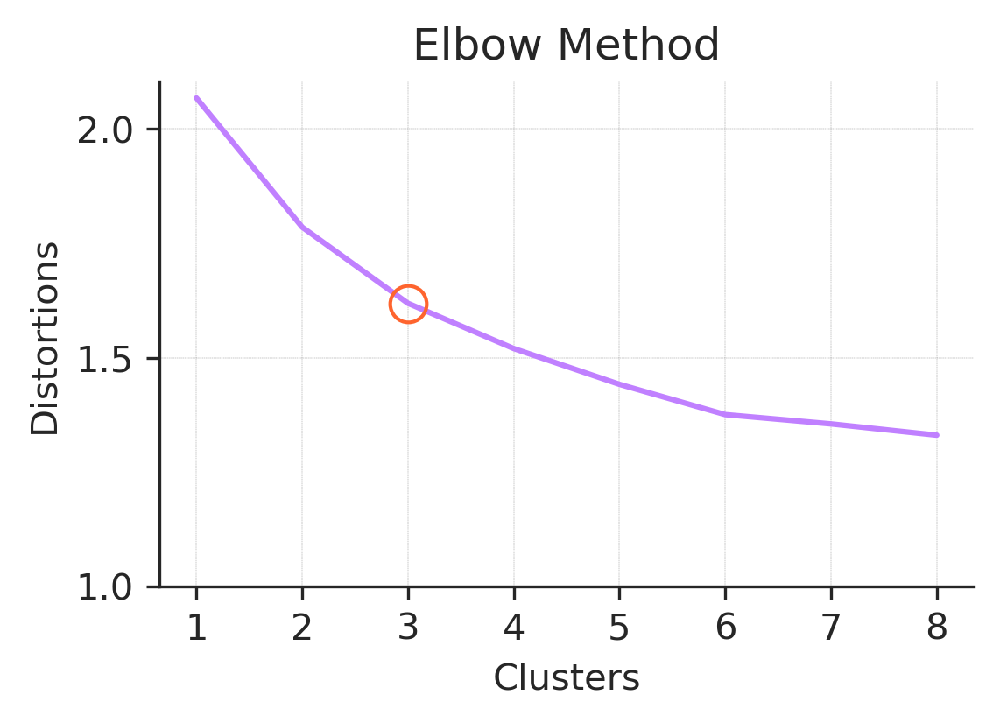

In [181]:
fig, ax = plt.subplots(figsize=[4,2.5],dpi=300)
ax.plot(c, iner,c='#c080ff')
ax.set_title('Elbow Method')
ax.set_xlabel('Clusters')
ax.set_ylabel('Distortions')

ax.plot(c[2], iner[2], marker='o', markersize=10, color='#fe642e', fillstyle='none')

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

ax.set_xticks(c)
ax.set_yticks([1, 1.5, 2,])

ax.grid(ls='--',lw=0.1,alpha=0.5,color='k')
plt.show()

In [182]:
num = 3
som = mySOM(m=num, n=1, dim=1336)
som.fit(spei_SOM)
predictions = som.predict(spei_SOM)

In [183]:
weeks = np.arange(0,1638)
onset_week = np.nanmean(onset,axis=(1,2))

pred_result = []
index_arr2 = 0

for item in onset_week:
    if np.isnan(item):
        pred_result.append(np.nan)
    else:
        pred_result.append(predictions[index_arr2])
        index_arr2 += 1

In [184]:
df = pd.DataFrame({'weeks': weeks, 
                   'onset_week': onset_week, 
                   'pred_result': pred_result})
# df.to_csv('cluster_fd.csv', index=False)

names = locals()
for i in range(0,num):
    names['spei'+str(i)] = spei_w[np.array(pred_result) == i]

In [185]:
df

,weeks,onset_week,pred_result
0,0,NaN,NaN
1,1,NaN,NaN
2,2,1.0,0.0
3,3,1.0,0.0
4,4,1.0,2.0
...,...,...,...
1633,1633,1.0,0.0
1634,1634,1.0,2.0
1635,1635,1.0,2.0
1636,1636,1.0,2.0


# Cluster result

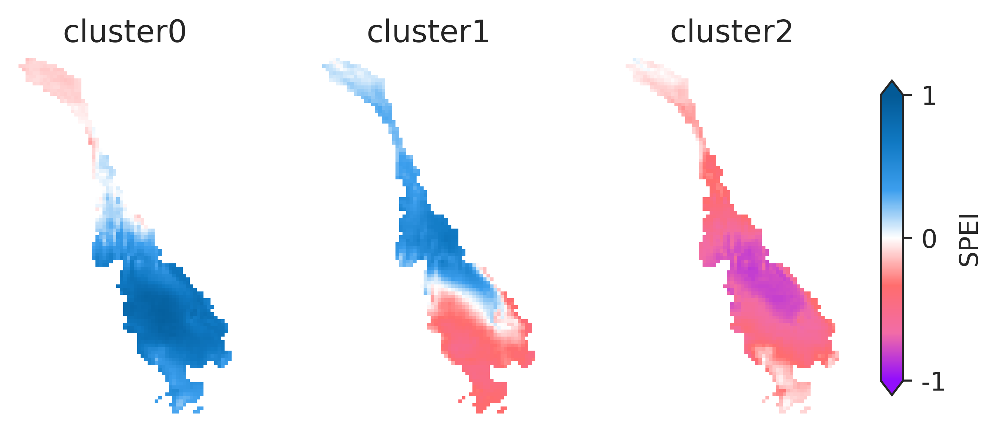

In [186]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 3, figsize=(6, 2.5), dpi=500)
images = []

namessperc_on = ['cluster0', 'cluster1', 'cluster2',]
cluster_speifd = [np.nanmean(spei0,axis=0),np.nanmean(spei1,axis=0),np.nanmean(spei2,axis=0),]

for i, (qt, subplot, name) in enumerate(zip(cluster_speifd, ax.flat, namessperc_on)):
    im = subplot.imshow(qt, cmap=cmap5.reversed(), interpolation='nearest',vmin=-1,vmax=1)
    images.append(im)
    subplot.set_xticks([])
    subplot.set_yticks([])
    subplot.set_frame_on(False)
    ax[-1,].axis('off')
    subplot.set_title(name)

cax = fig.add_axes([0.92, 0.15, 0.02, 0.68])
cbar = plt.colorbar(im, cax=cax, extend='both')
cbar.set_ticks([-1,0,1])
cbar.set_ticklabels(['-1','0','1'])
cbar.set_label('SPEI')

plt.savefig('Fig_save/cluster_spei_wet1.pdf')
plt.show()

In [187]:
spei0_0 = np.where(np.nanmean(spei0,axis=0)>0, np.nan, np.nanmean(spei0,axis=0))
spei1_0 = np.where(np.nanmean(spei1,axis=0)>0, np.nan, np.nanmean(spei1,axis=0))
spei2_0 = np.where(np.nanmean(spei2,axis=0)>0, np.nan, np.nanmean(spei2,axis=0))

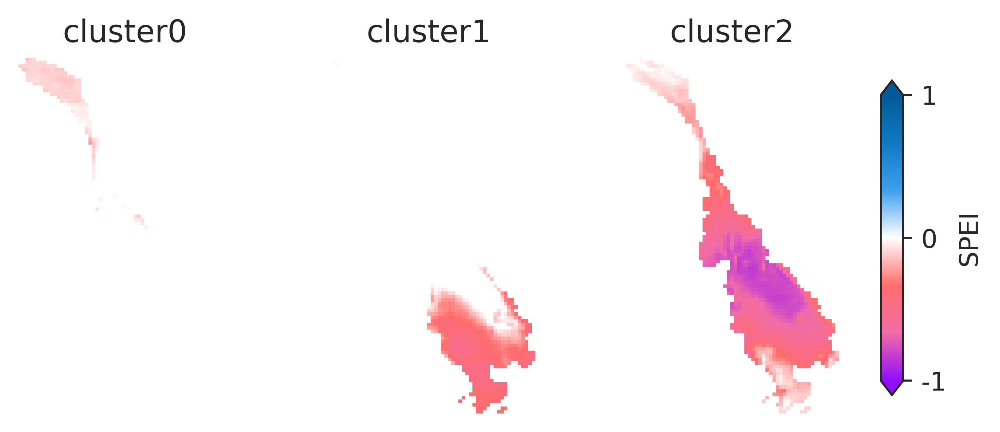

In [188]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 3, figsize=(6, 2.5), dpi=500)
images = []

namessperc_on = ['cluster0', 'cluster1', 'cluster2',]
cluster_spei_0 = [spei0_0,spei1_0,spei2_0]

for i, (qt, subplot, name) in enumerate(zip(cluster_spei_0, ax.flat, namessperc_on)):
    im = subplot.imshow(qt, cmap=cmap5.reversed(), interpolation='nearest',vmin=-1,vmax=1)
    images.append(im)
    subplot.set_xticks([])
    subplot.set_yticks([])
    subplot.set_frame_on(False)
    ax[-1,].axis('off')
    subplot.set_title(name)

cax = fig.add_axes([0.92, 0.15, 0.02, 0.68])
cbar = plt.colorbar(im, cax=cax, extend='both')
cbar.set_ticks([-1,0,1])
cbar.set_ticklabels(['-1','0','1'])
cbar.set_label('SPEI')

plt.savefig('Fig_save/cluster_spei_wet2.pdf')
plt.show()

# Early mete condation 

In [189]:
ds_nf = xr.open_dataset('mete_week/nflux/weekly_nflux.nc')
ds_ef = xr.open_dataset('mete_week/eflux/weekly_eflux.nc')
ds_gph = xr.open_dataset('mete_week/GPH/weekly_GPH.nc')
ds_sst = xr.open_dataset('mete_week/SST/weekly_SST.nc')
ds_mosdiv = xr.open_dataset('mete_week/mos_div/weekly_mosdiv.nc')
ds_cin = xr.open_dataset('mete_week/CIN/weekly_CIN.nc')

# wet season !!!

In [190]:
ds_nf_wet=ds_nf.sel(time=((ds_nf.time.dt.month == 5) | (ds_nf.time.dt.month == 6) |
                      (ds_nf.time.dt.month == 7) | (ds_nf.time.dt.month == 8) |
                      (ds_nf.time.dt.month == 9) | (ds_nf.time.dt.month == 10)))

ds_ef_wet=ds_ef.sel(time=((ds_ef.time.dt.month == 5) | (ds_ef.time.dt.month == 6) |
                      (ds_ef.time.dt.month == 7) | (ds_ef.time.dt.month == 8) |
                      (ds_ef.time.dt.month == 9) | (ds_ef.time.dt.month == 10)))

ds_gph_wet=ds_gph.sel(time=((ds_gph.time.dt.month == 5) | (ds_gph.time.dt.month == 6) |
                      (ds_gph.time.dt.month == 7) | (ds_gph.time.dt.month == 8) |
                      (ds_gph.time.dt.month == 9) | (ds_gph.time.dt.month == 10)))

ds_sst_wet=ds_sst.sel(time=((ds_sst.time.dt.month == 5) | (ds_sst.time.dt.month == 6) |
                      (ds_sst.time.dt.month == 7) | (ds_sst.time.dt.month == 8) |
                      (ds_sst.time.dt.month == 9) | (ds_sst.time.dt.month == 10)))

ds_mosdiv_wet=ds_mosdiv.sel(time=((ds_mosdiv.time.dt.month == 5) | (ds_mosdiv.time.dt.month == 6) |
                      (ds_mosdiv.time.dt.month == 7) | (ds_mosdiv.time.dt.month == 8) |
                      (ds_mosdiv.time.dt.month == 9) | (ds_mosdiv.time.dt.month == 10)))

ds_cin_wet=ds_cin.sel(time=((ds_cin.time.dt.month == 5) | (ds_cin.time.dt.month == 6) |
                      (ds_cin.time.dt.month == 7) | (ds_cin.time.dt.month == 8) |
                      (ds_cin.time.dt.month == 9) | (ds_cin.time.dt.month == 10)))


In [191]:
sst = ds_sst_wet.sst.values
gph = ds_gph_wet.z.values
nf = ds_nf_wet['p72.162'].values
ef = ds_ef_wet['p71.162'].values
mosdiv = ds_mosdiv_wet['p84.162'].values
cin = ds_cin_wet['cin'].values

In [192]:
sst_m = np.nanmean(sst,axis=0)
gph_m = np.nanmean(gph,axis=0)
nf_m = np.nanmean(nf,axis=0)
ef_m = np.nanmean(ef,axis=0)
mosdiv_m = np.nanmean(mosdiv,axis=0)
cin_m = np.nanmean(cin,axis=0)

In [193]:
names = locals()
for i in range(0,3):
    names['sst_onset'+str(i)]=np.nanmean(sst[df[df['pred_result']==i].index.tolist()],axis=0) - sst_m
    names['gph_onset'+str(i)]=np.nanmean(gph[df[df['pred_result']==i].index.tolist()],axis=0) - gph_m
    names['nf_onset'+str(i)]=np.nanmean(nf[df[df['pred_result']==i].index.tolist()],axis=0) - nf_m
    names['ef_onset'+str(i)]=np.nanmean(ef[df[df['pred_result']==i].index.tolist()],axis=0) - ef_m
    names['mosdiv_onset'+str(i)]=np.nanmean(mosdiv[df[df['pred_result']==i].index.tolist()],axis=0) - mosdiv_m
    names['cin_onset'+str(i)]=np.nanmean(cin[df[df['pred_result']==i].index.tolist()],axis=0) - cin_m
    
    index_lag1 = [index - 1 for index in df[df['pred_result'] == i].index.tolist()]
    names['sst_lag1'+str(i)]=np.nanmean(sst[index_lag1],axis=0) - sst_m
    names['gph_lag1'+str(i)]=np.nanmean(gph[index_lag1],axis=0) - gph_m
    names['nf_lag1'+str(i)]=np.nanmean(nf[index_lag1],axis=0) - nf_m
    names['ef_lag1'+str(i)]=np.nanmean(ef[index_lag1],axis=0) - ef_m
    names['mosdiv_lag1'+str(i)]=np.nanmean(mosdiv[index_lag1],axis=0) - mosdiv_m
    names['cin_lag1'+str(i)]=np.nanmean(cin[index_lag1],axis=0) - cin_m
    names['spei_lag1'+str(i)]=np.nanmean(spei_w[index_lag1],axis=0)
    names['spei_lag1'+str(i)] = np.where(np.array(names['spei_lag1'+str(i)])>0, np.nan, names['spei_lag1'+str(i)])
    
    index_lag2 = [index - 2 for index in df[df['pred_result'] == i].index.tolist()]
    names['sst_lag2'+str(i)]=np.nanmean(sst[index_lag2],axis=0) - sst_m
    names['gph_lag2'+str(i)]=np.nanmean(gph[index_lag2],axis=0) - gph_m
    names['nf_lag2'+str(i)]=np.nanmean(nf[index_lag2],axis=0) - nf_m
    names['mosdiv_lag2'+str(i)]=np.nanmean(mosdiv[index_lag2],axis=0) - mosdiv_m
    names['ef_lag2'+str(i)]=np.nanmean(ef[index_lag2],axis=0) - ef_m
    names['cin_lag2'+str(i)]=np.nanmean(cin[index_lag2],axis=0) - cin_m
    names['spei_lag2'+str(i)]=np.nanmean(spei_w[index_lag2],axis=0)
    names['spei_lag2'+str(i)] = np.where(np.array(names['spei_lag2'+str(i)])>0, np.nan, names['spei_lag2'+str(i)])

    
    index_after1 = [index + 1 for index in df[df['pred_result'] == i].index.tolist()]
    index_after1 = index_after1[:-2]
    names['sst_after1'+str(i)]=np.nanmean(sst[index_after1],axis=0) - sst_m
    names['gph_after1'+str(i)]=np.nanmean(gph[index_after1],axis=0) - gph_m
    names['nf_after1'+str(i)]=np.nanmean(nf[index_after1],axis=0) - nf_m
    names['ef_after1'+str(i)]=np.nanmean(ef[index_after1],axis=0) - ef_m
    names['mosdiv_after1'+str(i)]=np.nanmean(mosdiv[index_after1],axis=0) - mosdiv_m
    names['cin_after1'+str(i)]=np.nanmean(cin[index_after1],axis=0) - cin_m
    names['spei_after1'+str(i)]=np.nanmean(spei_w[index_after1],axis=0)
    names['spei_after1'+str(i)] = np.where(np.array(names['spei_after1'+str(i)]) > 0, np.nan, names['spei_after1'+str(i)])


In [194]:
clist7=['#ffffff','#ff6d6d','#f26ca7','#920efc']
cmap7 = LinearSegmentedColormap.from_list('chaos',clist7)

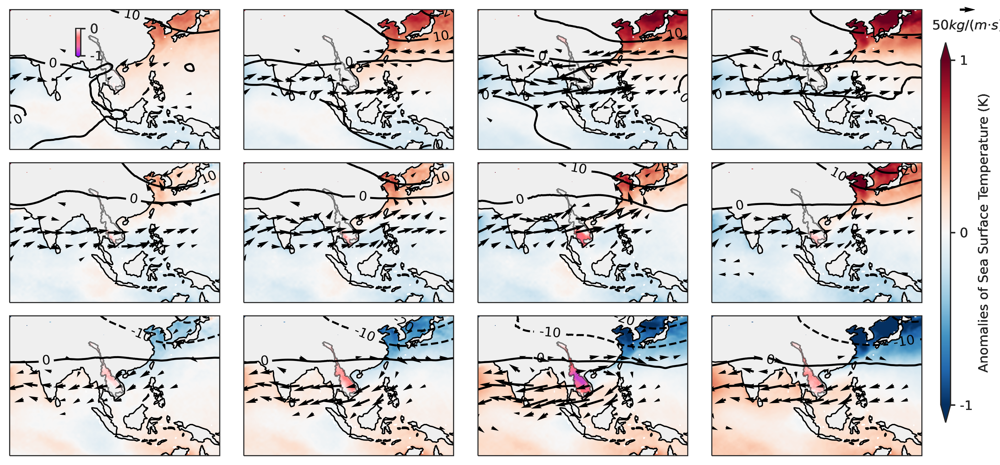

In [195]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs

lon_r = np.linspace(93.75, 108.75, 61)
lat_r = np.linspace(33.75, 8.5, 102)

lon = np.linspace(60, 150, 361)
lat = np.linspace(45, -15, 241)
g = 9.8
fig, axes = plt.subplots(nrows=3,ncols=4,figsize=(10,5),dpi=300,subplot_kw={'projection': ccrs.PlateCarree()})
ssstt = [sst_lag20,sst_lag10,sst_onset0,sst_after10,sst_lag21,sst_lag11,sst_onset1,sst_after11,sst_lag22,sst_lag12,sst_onset2,sst_after12,]
gphhh = [gph_lag20/g,gph_lag10/g,gph_onset0/g,gph_after10/g,gph_lag21/g,gph_lag11/g,gph_onset1/g,gph_after11/g,gph_lag22/g,gph_lag12/g,gph_onset2/g,gph_after12/g,]
efff = [ef_lag20,ef_lag10,ef_onset0,ef_after10,ef_lag21,ef_lag11,ef_onset1,ef_after11,ef_lag22,ef_lag12,ef_onset2,ef_after12,]
nfff = [nf_lag20,nf_lag10,nf_onset0,nf_after10,nf_lag21,nf_lag11,nf_onset1,nf_after11,nf_lag22,nf_lag12,nf_onset2,nf_after12,]
cluster_spei_0 = [spei_lag20,spei_lag10,spei0_0,spei_after10,spei_lag21,spei_lag11,spei1_0,spei_after11,spei_lag22,spei_lag12,spei2_0,spei_after12,]
clist=['#000000','#000000','#000000']
newcmp = LinearSegmentedColormap.from_list('chaos',clist)
for i, (ax,sstt,gphh,eff,nff,spei_00) in enumerate(zip(axes.flat,ssstt,gphhh,efff,nfff,cluster_spei_0)):
    projection = ccrs.PlateCarree()
    uv = np.sqrt(eff**2+nff**2)
    uv_masked = np.ma.masked_array(uv)
    uv_masked[uv_masked<20] = np.ma.masked

    extent = [60, 150, -11.011, 35.384]
    ax.set_extent(extent)
    ax.coastlines()

    im_sst = ax.imshow(sstt, extent=[60, 150, -15, 45], transform=projection,
                   vmin=-1,vmax=1, cmap='RdBu_r')
    
    cax = fig.add_axes([1.0, 0.10, 0.01, 0.8]) 
    cbar_sst = plt.colorbar(im_sst, cax=cax, extend='both')
    cbar_sst.set_label('Anomalies of Sea Surface Temperature (K)')
    cbar_sst.set_ticks([-1,0,1,])
    cbar_sst.set_ticklabels(['-1','0','1'])
    
    im_spei = ax.imshow(spei_00, extent=[93.75, 108.75, 8.5, 33.75], transform=projection,
                 vmin=-1,vmax=1, cmap=cmap7.reversed())
    im_spei.set_clim(vmin=-1, vmax=0)
    cax = fig.add_axes([0.09, 0.87, 0.005, 0.06]) 
    cbar_spei = plt.colorbar(im_spei, cax=cax, extend='min')
    # cbar_spei.set_label('SPEI')
    cbar_spei.set_ticks([-1,0])
    cbar_spei.set_ticklabels(['-1','0',])
    
    ax.add_feature(cfeature.LAND, facecolor='#efefef',)
    gaps = 24
    Q = ax.quiver(lon[::gaps], lat[::gaps], eff[::gaps,::gaps], nff[::gaps,::gaps],
                  uv_masked[::gaps,::gaps],width=0.01,scale=700, cmap=newcmp,
                  headwidth=2.5)
    qk = ax.quiverkey(Q, 1.028, 0.97, 50,  r'$50 kg/(m·s)$', labelpos='S',
                   coordinates='figure')
    CL = ax.contour(lon, lat, gphh, colors='k',transform=ccrs.PlateCarree(),
                    levels=np.arange(-20,21,10),ls='dotted')
    ax.clabel(CL,fontsize=10,fmt='%.0f')
    ax = stack_shp(ax,shp,facecolor='None',edgecolor='k',linewidth=0.75,alpha=0.5)
plt.tight_layout()
plt.show()


In [196]:
clist8=['#354482','#6877b5','#a1aad1','#ffffff','#ffffff','#f2b099','#e9754d','#701d01']
cmap8 = LinearSegmentedColormap.from_list('chaos',clist8)

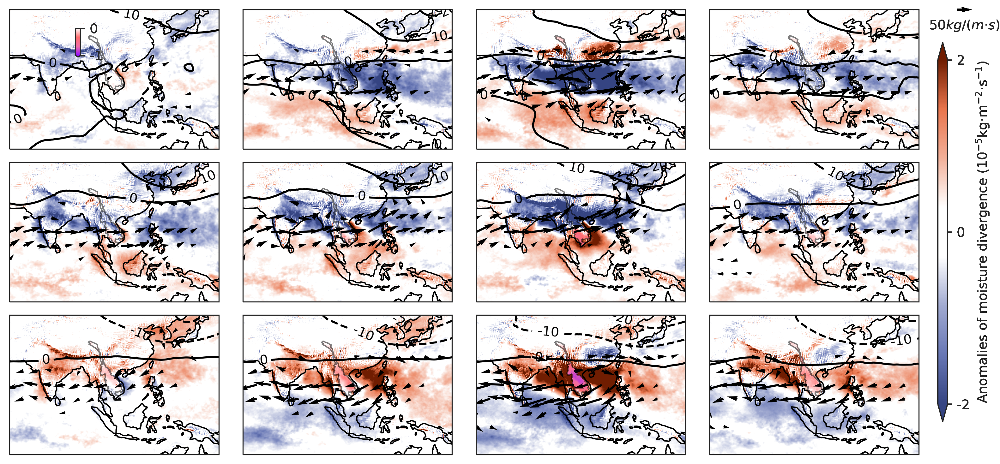

In [197]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs

lon_r = np.linspace(93.75, 108.75, 61)
lat_r = np.linspace(33.75, 8.5, 102)

lon = np.linspace(60, 150, 361)
lat = np.linspace(45, -15, 241)
g = 9.8
fig, axes = plt.subplots(nrows=3,ncols=4,figsize=(10,5),dpi=300,subplot_kw={'projection': ccrs.PlateCarree()})
mosd = [mosdiv_lag20,mosdiv_lag10,mosdiv_onset0,mosdiv_after10,mosdiv_lag21,mosdiv_lag11,mosdiv_onset1,mosdiv_after11,mosdiv_lag22,mosdiv_lag12,mosdiv_onset2,mosdiv_after12,]
gphhh = [gph_lag20/g,gph_lag10/g,gph_onset0/g,gph_after10/g,gph_lag21/g,gph_lag11/g,gph_onset1/g,gph_after11/g,gph_lag22/g,gph_lag12/g,gph_onset2/g,gph_after12/g,]
efff = [ef_lag20,ef_lag10,ef_onset0,ef_after10,ef_lag21,ef_lag11,ef_onset1,ef_after11,ef_lag22,ef_lag12,ef_onset2,ef_after12,]
nfff = [nf_lag20,nf_lag10,nf_onset0,nf_after10,nf_lag21,nf_lag11,nf_onset1,nf_after11,nf_lag22,nf_lag12,nf_onset2,nf_after12,]
cluster_spei_0 = [spei_lag20,spei_lag10,spei0_0,spei_after10,spei_lag21,spei_lag11,spei1_0,spei_after11,spei_lag22,spei_lag12,spei2_0,spei_after12,]
clist=['#000000','#000000','#000000']
newcmp = LinearSegmentedColormap.from_list('chaos',clist)
for i, (ax,mosdd,gphh,eff,nff,spei_00) in enumerate(zip(axes.flat,mosd,gphhh,efff,nfff,cluster_spei_0)):
    projection = ccrs.PlateCarree()
    uv = np.sqrt(eff**2+nff**2)
    uv_masked = np.ma.masked_array(uv)
    uv_masked[uv_masked<20] = np.ma.masked

    extent = [60, 150, -11.011, 35.384]
    ax.set_extent(extent)
    ax.coastlines()

    im_mosd = ax.imshow(mosdd, extent=[60, 150, -15, 45], transform=projection,
                   vmin=-0.00002,vmax=0.00002, cmap=cmap8)#'RdBu_r')
    
    cax = fig.add_axes([1.0, 0.10, 0.01, 0.8]) 
    cbar_mosd = plt.colorbar(im_mosd, cax=cax, extend='both')
    cbar_mosd.set_label('Anomalies of moisture divergence (10$^{-5}$kg·m$^{-2}$·s$^{-1}$)')
    cbar_mosd.set_ticks([-0.00002,0,0.00002,])
    cbar_mosd.set_ticklabels(['-2','0','2'])
    
    im_spei = ax.imshow(spei_00, extent=[93.75, 108.75, 8.5, 33.75], transform=projection,
                 vmin=-1,vmax=1, cmap=cmap7.reversed())
    im_spei.set_clim(vmin=-1, vmax=0)
    cax = fig.add_axes([0.09, 0.87, 0.005, 0.06]) 
    cbar_spei = plt.colorbar(im_spei, cax=cax, extend='min')
    # cbar_spei.set_label('SPEI')
    cbar_spei.set_ticks([-1,0])
    cbar_spei.set_ticklabels(['-1','0',])
    
    ax.add_feature(cfeature.LAND, facecolor='#efefef',)
    gaps = 24
    Q = ax.quiver(lon[::gaps], lat[::gaps], eff[::gaps,::gaps], nff[::gaps,::gaps],
                  uv_masked[::gaps,::gaps],width=0.01,scale=700, cmap=newcmp,
                  headwidth=2.5)
    qk = ax.quiverkey(Q, 1.028, 0.97, 50,  r'$50 kg/(m·s)$', labelpos='S',
                   coordinates='figure')
    CL = ax.contour(lon, lat, gphh, colors='k',transform=ccrs.PlateCarree(),
                    levels=np.arange(-20,21,10),ls='dotted')
    ax.clabel(CL,fontsize=10,fmt='%.0f')
    ax = stack_shp(ax,shp,facecolor='None',edgecolor='k',linewidth=0.75,alpha=0.5)
plt.tight_layout()
plt.show()

In [198]:
clist9=['#9c5101','#e59034','#efba80','#ffffff','#ffffff','#84c5a5','#21965d','#066135']
cmap9 = LinearSegmentedColormap.from_list('chaos',clist9)

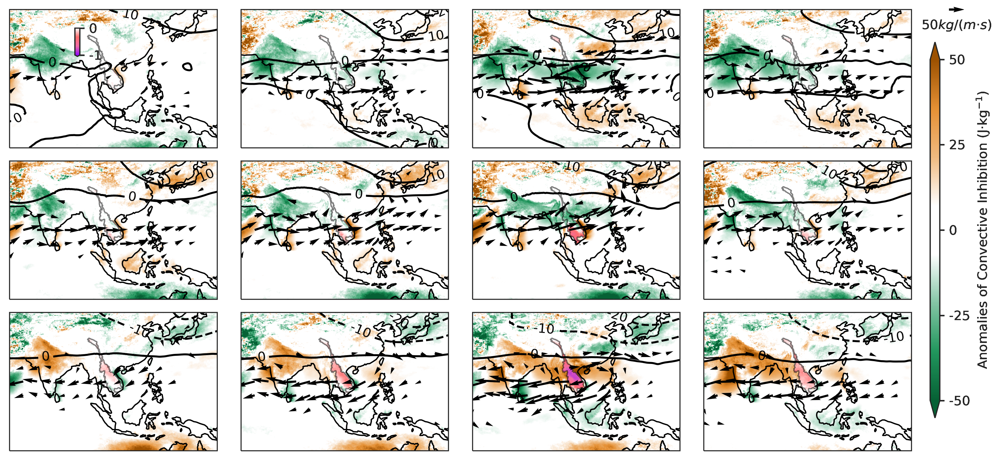

In [199]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs

lon_r = np.linspace(93.75, 108.75, 61)
lat_r = np.linspace(33.75, 8.5, 102)

lon = np.linspace(60, 150, 361)
lat = np.linspace(45, -15, 241)
g = 9.8
fig, axes = plt.subplots(nrows=3,ncols=4,figsize=(10,5),dpi=300,subplot_kw={'projection': ccrs.PlateCarree()})
cinn = [cin_lag20,cin_lag10,cin_onset0,cin_after10,cin_lag21,cin_lag11,cin_onset1,cin_after11,cin_lag22,cin_lag12,cin_onset2,cin_after12,]
gphhh = [gph_lag20/g,gph_lag10/g,gph_onset0/g,gph_after10/g,gph_lag21/g,gph_lag11/g,gph_onset1/g,gph_after11/g,gph_lag22/g,gph_lag12/g,gph_onset2/g,gph_after12/g,]
efff = [ef_lag20,ef_lag10,ef_onset0,ef_after10,ef_lag21,ef_lag11,ef_onset1,ef_after11,ef_lag22,ef_lag12,ef_onset2,ef_after12,]
nfff = [nf_lag20,nf_lag10,nf_onset0,nf_after10,nf_lag21,nf_lag11,nf_onset1,nf_after11,nf_lag22,nf_lag12,nf_onset2,nf_after12,]
cluster_spei_0 = [spei_lag20,spei_lag10,spei0_0,spei_after10,spei_lag21,spei_lag11,spei1_0,spei_after11,spei_lag22,spei_lag12,spei2_0,spei_after12,]
clist=['#000000','#000000','#000000']
newcmp = LinearSegmentedColormap.from_list('chaos',clist)
for i, (ax,cinnn,gphh,eff,nff,spei_00) in enumerate(zip(axes.flat,cinn,gphhh,efff,nfff,cluster_spei_0)):
    projection = ccrs.PlateCarree()
    uv = np.sqrt(eff**2+nff**2)
    uv_masked = np.ma.masked_array(uv)
    uv_masked[uv_masked<20] = np.ma.masked

    extent = [60, 150, -11.011, 35.384]
    ax.set_extent(extent)
    ax.coastlines()

    im_cinn = ax.imshow(cinnn, extent=[60, 150, -15, 45], transform=projection,
                   vmin=-50,vmax=50, cmap= cmap9.reversed())#'RdBu_r')
    
    cax = fig.add_axes([1.0, 0.10, 0.01, 0.8]) 
    cbar_cinn = plt.colorbar(im_cinn, cax=cax, extend='both')
    cbar_cinn.set_label('Anomalies of Convective Inhibition (J·kg$^{-1}$)')
    cbar_cinn.set_ticks([-50,-25,0,25,50])
    cbar_cinn.set_ticklabels(['-50','-25','0','25','50'])
    
    im_spei = ax.imshow(spei_00, extent=[93.75, 108.75, 8.5, 33.75], transform=projection,
                 vmin=-1,vmax=1, cmap=cmap7.reversed())
    im_spei.set_clim(vmin=-1, vmax=0)
    cax = fig.add_axes([0.09, 0.87, 0.005, 0.06]) 
    cbar_spei = plt.colorbar(im_spei, cax=cax, extend='min')
    # cbar_spei.set_label('SPEI')
    cbar_spei.set_ticks([-1,0])
    cbar_spei.set_ticklabels(['-1','0',])
    
    ax.add_feature(cfeature.LAND, facecolor='#efefef',)
    gaps = 24
    Q = ax.quiver(lon[::gaps], lat[::gaps], eff[::gaps,::gaps], nff[::gaps,::gaps],
                  uv_masked[::gaps,::gaps],width=0.01,scale=700, cmap=newcmp,
                  headwidth=2.5)
    qk = ax.quiverkey(Q, 1.028, 0.97, 50,  r'$50 kg/(m·s)$', labelpos='S',
                   coordinates='figure')
    CL = ax.contour(lon, lat, gphh, colors='k',transform=ccrs.PlateCarree(),
                    levels=np.arange(-20,21,10),ls='dotted')
    ax.clabel(CL,fontsize=10,fmt='%.0f')
    ax = stack_shp(ax,shp,facecolor='None',edgecolor='k',linewidth=0.75,alpha=0.5)
plt.tight_layout()
plt.show()

In [200]:
cluster_year = df['pred_result'].values.reshape(63,26)
cluster_week = cluster_year.transpose(1,0)

clu_we = []
for i in range(0,26):
    for j in range(0,3):
        clu_we.append(np.count_nonzero(cluster_week[i]==j))

clu_we = np.array(clu_we).reshape(26,3).transpose(1,0)

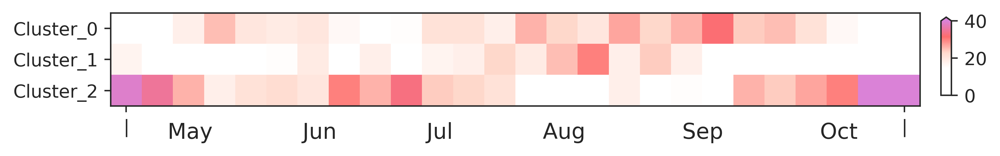

In [201]:
clist6=['#ffffff','#ffffff','#ffd9cc','#fe6d6d','#da82d7']
cmap6 = LinearSegmentedColormap.from_list('chaos',clist6)

fig, ax = plt.subplots( figsize=(8,5), dpi=500)
im = ax.imshow(clu_we, cmap=cmap6,vmax=40)
cax = fig.add_axes([0.92, 0.44, 0.01, 0.12])
cbar = plt.colorbar(im, cax=cax, extend='max')
cbar.set_ticks([0,20,40])
cbar.set_ticklabels(['0','20','40',])


ax.set_yticks([0,1,2])  
ax.set_yticklabels(['Cluster_0', 'Cluster_1','Cluster_2'])  
ax.set_xticks([0,25]) 
ax.set_xticklabels(['|', '|'])   
ax.text(0.923, -0.17, 'May             Jun             Jul             Aug              Sep              Oct', 
        ha='right', va='top',fontsize=12, transform=ax.transAxes)
plt.show()

In [202]:
clu_ye = []
for i in range(0,63):
    for j in range(0,3):
        clu_ye.append(np.count_nonzero(cluster_year[i]==j))
clu_ye = np.array(clu_ye).reshape(63,3)

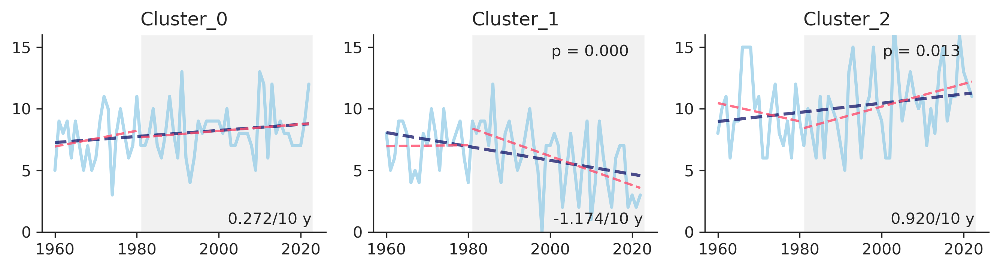

In [203]:
import matplotlib.pyplot as plt
from matplotlib.ticker import PercentFormatter

clu_year = [clu_ye[:,0],clu_ye[:,1],clu_ye[:,2]]
namess = ['Cluster_0', 'Cluster_1', 'Cluster_2']
x = np.arange(63)
x1 = np.arange(0,21)
x2 = np.arange(21,63)
fig, axes = plt.subplots(1, 3, figsize=(9, 2.5), dpi=300)

for i, ax in enumerate(axes.flat):
    slope, intercept, r_value, p_value, std_err = linregress(x, clu_year[i])
    slope1, intercept1, r_value1, p_value1, std_err1 = linregress(x1, clu_year[i][0:21])
    slope2, intercept2, r_value2, p_value2, std_err2 = linregress(x2, clu_year[i][21:63])
    ax.plot(clu_year[i],color="#8ecae6",lw=2,alpha=0.7)
    ax.set_title(namess[i])
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.set_xticks([0, 20, 40, 60])  
    ax.set_xticklabels(['1960',  '1980', '2000', '2020'])  
    ax.set_yticks([0,5,10,15])  
    ax.set_yticklabels(['0','5','10','15'])  
    ax.plot(x, intercept + slope * x, color='#03045e', linestyle='--',lw= 2,alpha=0.7)
    ax.plot(x1, intercept1 + slope1 * x1, color='#ff4d6d', linestyle='--',lw= 1.5,alpha=0.8)
    ax.plot(x2, intercept2 + slope2 * x2, color='#ff4d6d', linestyle='--',lw= 1.5,alpha=0.8)
    ax.axvspan(21, 63, facecolor='lightgray', alpha=0.3)
    ax.set_ylim(0, 16)
    ax.text(0.95, 0.1, f'{slope2*10:.3f}/10 y', ha='right', va='top', transform=ax.transAxes)
    ax.xaxis.set_ticks_position('bottom')  
    ax.yaxis.set_ticks_position('left') 
    if p_value2 < 0.05:
        ax.text(0.90, 0.95, f'p = {p_value2:.3f}', ha='right', va='top', transform=ax.transAxes)

        
plt.tight_layout()
plt.show()

# Quantify the change process of moisture divergence and CIN

In [204]:
cinn = [cin_lag20,cin_lag10,cin_onset0,cin_after10,cin_lag21,cin_lag11,cin_onset1,cin_after11,cin_lag22,cin_lag12,cin_onset2,cin_after12,]
mosd = [mosdiv_lag20,mosdiv_lag10,mosdiv_onset0,mosdiv_after10,mosdiv_lag21,mosdiv_lag11,mosdiv_onset1,mosdiv_after11,mosdiv_lag22,mosdiv_lag12,mosdiv_onset2,mosdiv_after12,]

In [205]:
cinn_arr = np.array(cinn)# +cin_m
ds_cinn = xr.Dataset({'cin': (['cluster','lat', 'lon'], cinn_arr)},
                    coords={'cluster': (['cluster'], np.arange(0,12)),
                            'lon': (['lon'],ds_cin.lon.values),
                            'lat': (['lat'],ds_cin.lat.values)})

ds_cinnm = xr.Dataset({'cin': (['lat', 'lon'], cin_m)},
                    coords={'lon': (['lon'],ds_cin.lon.values),
                            'lat': (['lat'],ds_cin.lat.values)})


ds_cin_mk,_ = ncslice(ds_cinn,shp,18,index='LEGEND')
ds_cinm_mk,_ = ncslice(ds_cinnm,shp,18,index='LEGEND')
cin_bar = ds_cin_mk.cin.values
cin_bar_m = ds_cinm_mk.cin.values
for i in range(0,3):
    mask = ~np.isnan(names['spei'+str(i)+'_0'])
    names['cinbar'+str(i)]=np.empty_like(cin_bar[i*4:(i+1)*4], dtype=float)
    names['cinbar'+str(i)].fill(np.nan)
    names['cinbar'+str(i)][:,mask] = cin_bar[i*4:(i+1)*4][:,mask]

    names['cinbar_m'+str(i)]=np.empty_like(cin_bar_m, dtype=float)
    names['cinbar_m'+str(i)].fill(np.nan)
    names['cinbar_m'+str(i)][mask] = cin_bar_m[mask]



In [206]:
df_cin = pd.DataFrame(columns=['cinbar', 'values'])
for i in range(0,3):
    names['df_cin'+str(i)] = pd.DataFrame(columns=['cinbar', 'values'])
    
    for j in range(0,4):
        names['cinbar'+str(i)+str(j)] = names['cinbar'+str(i)][j]
        names['cinbar'+str(i)+str(j)] = names['cinbar'+str(i)+str(j)][~np.isnan(names['cinbar'+str(i)+str(j)])]
        names['df_cin'+str(i)] = pd.concat([names['df_cin'+str(i)], pd.DataFrame({'cinbar': ['lag'+str(i)+str(j)] * len(names['cinbar'+str(i)+str(j)]), 
                                              'values': names['cinbar'+str(i)+str(j)]})])

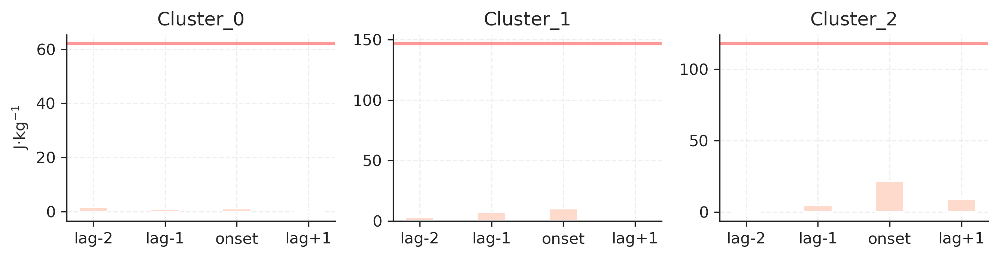

In [207]:
import matplotlib.pyplot as plt
from matplotlib.ticker import PercentFormatter

cinbar_clu = [np.nanmean(cinbar0,axis=(1,2)),np.nanmean(cinbar1,axis=(1,2)),np.nanmean(cinbar2,axis=(1,2))]
cinbar_m_clu = [np.nanmean(cinbar_m0),np.nanmean(cinbar_m1),np.nanmean(cinbar_m2)]
namess = ['Cluster_0', 'Cluster_1', 'Cluster_2']
x_label = ['lag-2','lag-1','onset','lag+1']
fig, axes = plt.subplots(1, 3, figsize=(9, 2.4), dpi=300)

for i, ax in enumerate(axes.flat):
    ax.set_title(namess[i])
    ax.grid(ls='--',alpha=0.3)
    ax.bar(x_label,cinbar_clu[i],color="#fedacd",width=0.4)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.axhline(y=cinbar_m_clu[i], color='red', ls='-', lw=2, label='Average',alpha=0.4)
    if i == 0:
        ax.set_ylabel('J·kg$^{-1}$')
plt.tight_layout()
plt.show()

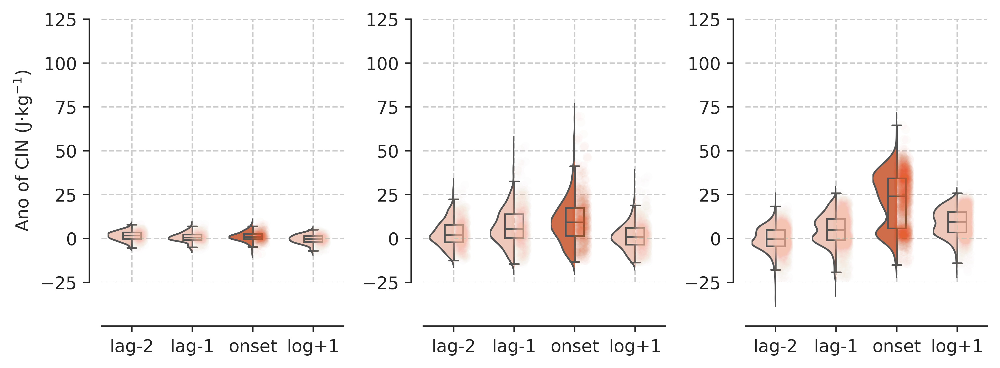

In [208]:
import matplotlib.pyplot as plt
import seaborn as sns

cin_palette = ["#f5c4b3", "#f5c4b3", "#e56134", "#f5c4b3",]
sns.set_palette(cin_palette)
palette = cin_palette
sns.set_style('white')

df_data = [df_cin0, df_cin1, df_cin2]
fig, axes = plt.subplots(1, 3, figsize=(8, 3), dpi=500)  # 创建一个包含3个子图的画布，比例为1:3

for i, ax in enumerate(axes):
    sns.violinplot(x="cinbar", y="values", data=df_data[i], hue="cinbar", dodge=False,
                   palette=palette, scale="area", inner=None, ax=ax, linewidth=1)  # 调整scale参数为"area"
    
    sns.set_style('ticks')
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()
    for violin in ax.collections:
        bbox = violin.get_paths()[0].get_extents()
        x0, y0, width, height = bbox.bounds
        violin.set_clip_path(plt.Rectangle((x0, y0), width / 2, height, transform=ax.transData))

    sns.boxplot(x="cinbar", y="values", data=df_data[i], saturation=1, showfliers=False,
                width=0.3, boxprops={'zorder': 3, 'facecolor': 'none'}, ax=ax, linewidth=1)
    old_len_collections = len(ax.collections)
    sns.stripplot(x="cinbar", y="values", data=df_data[i], hue="cinbar", palette=palette, dodge=False, ax=ax, alpha=0.02)
    for dots in ax.collections[old_len_collections:]:
        dots.set_offsets(dots.get_offsets() + np.array([0.12, 0]))
    ax.set_xlim(-0.5,3.5)
    ax.set_ylim(-25,125)
    ax.tick_params(left=True,bottom=True) 
    #ax.set_yticks([0,0.5,1,1.5,2])
    ax.set_xticklabels(['lag-2', 'lag-1', 'onset', 'log+1'])
    ax.legend_.remove()
    # ax.axhline(y=cinbar_m_clu[i], color='#5a189a', linestyle='--', linewidth=2)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_position(('data', -0.7))
    ax.spines['bottom'].set_position(('data', -50))
    ax.set_ylabel('Ano of CIN (J·kg$^{-1}$)')
    ax.set_xlabel('')
    ax.grid(ls='--')
    if i != 0:
        ax.set_ylabel('')
plt.tight_layout()
plt.savefig('Fig_save/CIN_wet_dots.pdf')
plt.show()

In [209]:
mosd_arr = np.array(mosd)# +mosdiv_m
ds_mosdivv = xr.Dataset({'p84.162': (['cluster','lat', 'lon'], mosd_arr)},
                    coords={'cluster': (['cluster'], np.arange(0,12)),
                            'lon': (['lon'],ds_mosdiv.lon.values),
                            'lat': (['lat'],ds_mosdiv.lat.values)})

ds_mosdivvm = xr.Dataset({'p84.162': (['lat', 'lon'], mosdiv_m)},
                    coords={'lon': (['lon'],ds_mosdiv.lon.values),
                            'lat': (['lat'],ds_mosdiv.lat.values)})

ds_mosdivv_mk,_ = ncslice(ds_mosdivv,shp,18,index='LEGEND')
ds_mosdivvm_mk,_ = ncslice(ds_mosdivvm,shp,18,index='LEGEND')
mosdiv_bar = ds_mosdivv_mk['p84.162'].values
mosdiv_bar_m = ds_mosdivvm_mk['p84.162'].values

for i in range(0,3):
    mask = ~np.isnan(names['spei'+str(i)+'_0'])
    names['mosdivbar'+str(i)]=np.empty_like(mosdiv_bar[i*4:(i+1)*4], dtype=float)
    names['mosdivbar'+str(i)].fill(np.nan)
    names['mosdivbar'+str(i)][:,mask] = mosdiv_bar[i*4:(i+1)*4][:,mask]

    names['mosdivbar_m'+str(i)]=np.empty_like(mosdiv_bar_m, dtype=float)
    names['mosdivbar_m'+str(i)].fill(np.nan)
    names['mosdivbar_m'+str(i)][mask] = mosdiv_bar_m[mask]

In [210]:
df_mosdiv = pd.DataFrame(columns=['mosdivbar', 'values'])
for i in range(0,3):
    names['df_mosdiv'+str(i)] = pd.DataFrame(columns=['cinbar', 'values'])
    
    for j in range(0,4):
        names['mosdivbar'+str(i)+str(j)] = names['mosdivbar'+str(i)][j]
        names['mosdivbar'+str(i)+str(j)] = names['mosdivbar'+str(i)+str(j)][~np.isnan(names['mosdivbar'+str(i)+str(j)])]
        names['df_mosdiv'+str(i)] = pd.concat([names['df_mosdiv'+str(i)], pd.DataFrame({'mosdivbar': ['lag'+str(i)+str(j)] * len(names['mosdivbar'+str(i)+str(j)]), 
                                              'values': names['mosdivbar'+str(i)+str(j)]})])

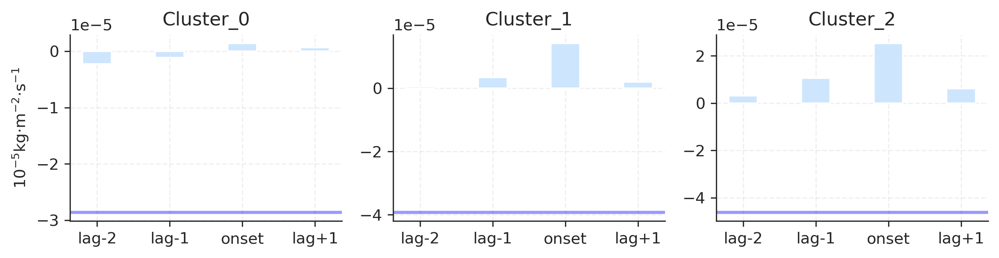

In [211]:
import matplotlib.pyplot as plt
from matplotlib.ticker import PercentFormatter

mosdivbar_clu = [np.nanmean(mosdivbar0,axis=(1,2)),np.nanmean(mosdivbar1,axis=(1,2)),np.nanmean(mosdivbar2,axis=(1,2))]
mosdivbar_m_clu = [np.nanmean(mosdivbar_m0),np.nanmean(mosdivbar_m1),np.nanmean(mosdivbar_m2)]
namess = ['Cluster_0', 'Cluster_1', 'Cluster_2']
x_label = ['lag-2','lag-1','onset','lag+1']
fig, axes = plt.subplots(1, 3, figsize=(9, 2.4), dpi=300)

for i, ax in enumerate(axes.flat):
    ax.set_title(namess[i])
    ax.grid(ls='--',alpha=0.3)
    ax.bar(x_label,mosdivbar_clu[i],color="#cde6fe",width=0.4)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.axhline(y=mosdivbar_m_clu[i], color='b', ls='-', lw=2, label='Average',alpha=0.4)
    
    if i == 0:
        ax.set_ylabel('10$^{-5}$kg·m$^{-2}$·s$^{-1}$')
plt.tight_layout()
plt.show()

In [212]:
mosdivbar_m_clu

[-2.8615075602962885e-05, -3.928481645382791e-05, -4.6260592698927577e-05]

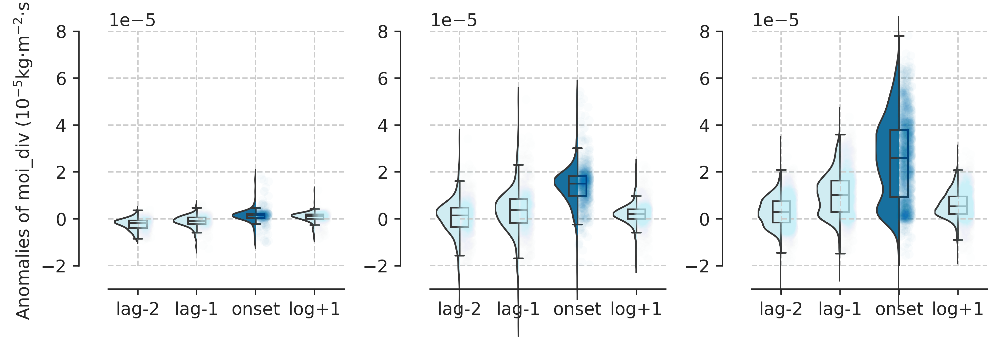

In [213]:
import matplotlib.pyplot as plt
import seaborn as sns

cin_palette = ["#caf0f8", "#caf0f8", "#0077b6", "#caf0f8",]
sns.set_palette(cin_palette)
palette = cin_palette
sns.set_style('white')

df_data = [df_mosdiv0, df_mosdiv1, df_mosdiv2]
fig, axes = plt.subplots(1, 3, figsize=(8, 3), dpi=500)  # 创建一个包含3个子图的画布，比例为1:3

for i, ax in enumerate(axes):
    sns.violinplot(x="mosdivbar", y="values", data=df_data[i], hue="mosdivbar", dodge=False,
                   palette=palette, scale="area", inner=None, ax=ax, linewidth=1)  # 调整scale参数为"area"
    sns.set_style('ticks')
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()
    for violin in ax.collections:
        bbox = violin.get_paths()[0].get_extents()
        x0, y0, width, height = bbox.bounds
        violin.set_clip_path(plt.Rectangle((x0, y0), width / 2, height, transform=ax.transData))

    sns.boxplot(x="mosdivbar", y="values", data=df_data[i], saturation=1, showfliers=False,
                width=0.3, boxprops={'zorder': 3, 'facecolor': 'none'}, ax=ax, linewidth=1)
    old_len_collections = len(ax.collections)
    ax.axhline(y=mosdivbar_m_clu[i], color='#5a189a', linestyle='--', linewidth=2)
    sns.stripplot(x="mosdivbar", y="values", data=df_data[i], hue="mosdivbar", palette=palette, dodge=False, ax=ax, alpha=0.02)
    for dots in ax.collections[old_len_collections:]:
        dots.set_offsets(dots.get_offsets() + np.array([0.12, 0]))
    # ax.set_xlim(-0.0002,0.0002)
    ax.set_ylim(-0.00002,0.00008)
    ax.tick_params(left=True,bottom=True) 
    #ax.set_yticks([0,0.5,1,1.5,2])
    ax.legend_.remove()
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_position(('data', -1))
    ax.spines['bottom'].set_position(('data', -0.00003))
    ax.set_xlabel('')
    ax.set_xticklabels(['lag-2', 'lag-1', 'onset', 'log+1'])
    ax.grid(ls='--')
    ax.set_ylabel('Anomalies of moi_div (10$^{-5}$kg·m$^{-2}$·s$^{-1}$)')
    if i != 0:
        ax.set_ylabel('')
        
plt.tight_layout()
#plt.savefig('Fig_save/mosd_wet_dots.pdf')
plt.show()

# dry season run this one !!!

In [145]:
onset = ds_dryon.onset.values
indices_to_keep = np.where(np.nanmean(onset,axis=(1,2)) == 1)[0]
spei_SOM = spei_d[indices_to_keep]
spei_SOM = spei_SOM.reshape(1454,6222)
spei_SOM = spei_SOM[~np.isnan(spei_SOM)]
spei_SOM = spei_SOM.reshape(1454,1336)

## SOM cluster map

In [146]:
c = []
iner = []
for k in range(0,8):
    num = k+1
    som = mySOM(m=num, n=1, dim=1336)
    som.fit(spei_SOM)
    predictions = som.predict(spei_SOM)
    cluster = predictions
    names = locals()
    for i in range(0,num):
        names['spei_SOM'+str(i)]=[]
        names['index'+str(i)] = np.argwhere(cluster==i)
        names['index'+str(i)] = names['index'+str(i)].reshape(names['index'+str(i)].shape[0])
        for j in range(0,names['index'+str(i)].shape[0]):
            names['spei_SOM'+str(i)] = np.append(names['spei_SOM'+str(i)],spei_SOM[names['index'+str(i)][j]])
        names['spei_SOM'+str(i)] = np.array(names['spei_SOM'+str(i)]).reshape(names['index'+str(i)].shape[0],1336)




    spei_som_ = []
    for i in range(0,num):
        spei_som_ = np.append(spei_som_,np.nanmean(names['spei_SOM'+str(i)],axis=0))
    spei_som_.reshape(num,1336).shape
    som._find_bmu(spei_som_.reshape(num,1336))
    print(som._inertia_/1000000)



    #fig = plt.figure(figsize=(8, 3), dpi=300)
    #plt.imshow(np.nanmean(gph5000,axis=0),vmax=5800,vmin=5400,cmap='plasma')
    #plt.colorbar()
    c.append(k+1)
    iner.append(som._inertia_/1000000)

1.9614068083482408
1.6523278082476058
1.4624535390082052
1.4022443009656334
1.347728336897198
1.273326528668494
1.261606485622834
1.2098142747841962


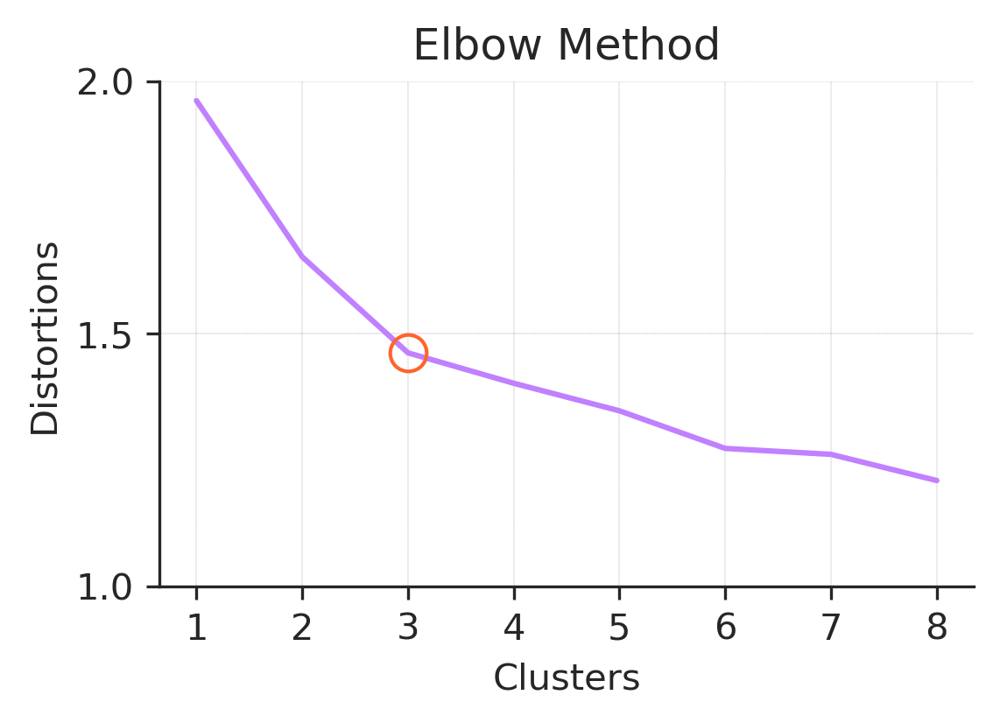

In [147]:
fig, ax = plt.subplots(figsize=[4,2.5],dpi=300)
ax.plot(c, iner,c='#c080ff')
ax.set_title('Elbow Method')
ax.set_xlabel('Clusters')
ax.set_ylabel('Distortions')

ax.plot(c[2], iner[2], marker='o', markersize=10, color='#fe642e', fillstyle='none')

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

ax.set_xticks(c)
ax.set_yticks([1, 1.5, 2,])

ax.grid(ls='--',lw=0.1,alpha=0.5,color='k')
plt.show()

In [148]:
num = 3
som = mySOM(m=num, n=1, dim=1336)
som.fit(spei_SOM)
predictions = som.predict(spei_SOM)

In [149]:
weeks = np.arange(0,1638)
onset_week = np.nanmean(onset,axis=(1,2))

pred_result = []
index_arr2 = 0

for item in onset_week:
    if np.isnan(item):
        pred_result.append(np.nan)
    else:
        pred_result.append(predictions[index_arr2])
        index_arr2 += 1

In [150]:
df = pd.DataFrame({'weeks': weeks, 
                   'onset_week': onset_week, 
                   'pred_result': pred_result})
# df.to_csv('cluster_fd.csv', index=False)

names = locals()
for i in range(0,num):
    names['spei'+str(i)] = spei_d[np.array(pred_result) == i]

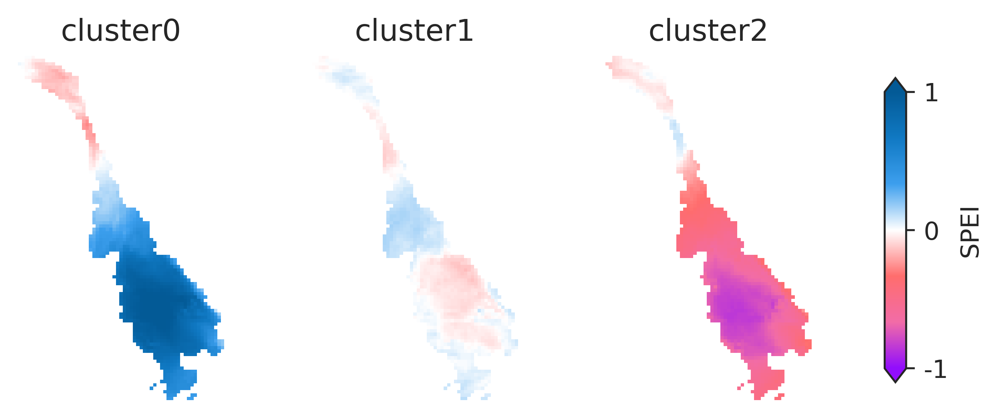

In [151]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 3, figsize=(6, 2.5), dpi=500)
images = []

namessperc_on = ['cluster0', 'cluster1', 'cluster2',]
cluster_speifd = [np.nanmean(spei0,axis=0),np.nanmean(spei1,axis=0),np.nanmean(spei2,axis=0),]

for i, (qt, subplot, name) in enumerate(zip(cluster_speifd, ax.flat, namessperc_on)):
    im = subplot.imshow(qt, cmap=cmap5.reversed(), interpolation='nearest',vmin=-1,vmax=1)
    images.append(im)
    subplot.set_xticks([])
    subplot.set_yticks([])
    subplot.set_frame_on(False)
    ax[-1,].axis('off')
    subplot.set_title(name)

cax = fig.add_axes([0.95, 0.15, 0.02, 0.68])
cbar = plt.colorbar(im, cax=cax, extend='both')
cbar.set_ticks([-1,0,1])
cbar.set_ticklabels(['-1','0','1'])
cbar.set_label('SPEI')

# plt.savefig('cluster_spei.pdf')
plt.show()

In [152]:
spei0_0 = np.where(np.nanmean(spei0,axis=0)>0, np.nan, np.nanmean(spei0,axis=0))
spei1_0 = np.where(np.nanmean(spei1,axis=0)>0, np.nan, np.nanmean(spei1,axis=0))
spei2_0 = np.where(np.nanmean(spei2,axis=0)>0, np.nan, np.nanmean(spei2,axis=0))

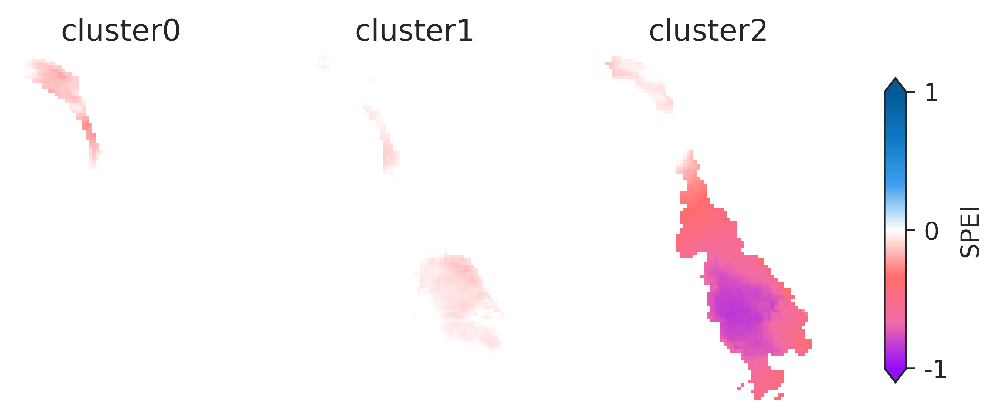

In [153]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 3, figsize=(6, 2.5), dpi=500)
images = []

namessperc_on = ['cluster0', 'cluster1', 'cluster2',]
cluster_spei_0 = [spei0_0,spei1_0,spei2_0]

for i, (qt, subplot, name) in enumerate(zip(cluster_spei_0, ax.flat, namessperc_on)):
    im = subplot.imshow(qt, cmap=cmap5.reversed(), interpolation='nearest',vmin=-1,vmax=1)
    images.append(im)
    subplot.set_xticks([])
    subplot.set_yticks([])
    subplot.set_frame_on(False)
    ax[-1,].axis('off')
    subplot.set_title(name)

cax = fig.add_axes([0.95, 0.15, 0.02, 0.68])
cbar = plt.colorbar(im, cax=cax, extend='both')
cbar.set_ticks([-1,0,1])
cbar.set_ticklabels(['-1','0','1'])
cbar.set_label('SPEI')

plt.savefig('Fig_save/cluster_spei_dry2.pdf')
plt.show()

In [154]:
ds_nf_dry=ds_nf.sel(time=((ds_nf.time.dt.month == 1) | (ds_nf.time.dt.month == 2) |
                      (ds_nf.time.dt.month == 3) | (ds_nf.time.dt.month == 4) |
                      (ds_nf.time.dt.month == 11) | (ds_nf.time.dt.month == 12)))

ds_ef_dry=ds_ef.sel(time=((ds_ef.time.dt.month == 1) | (ds_ef.time.dt.month == 2) |
                      (ds_ef.time.dt.month == 3) | (ds_ef.time.dt.month == 4) |
                      (ds_ef.time.dt.month == 11) | (ds_ef.time.dt.month == 12)))

ds_gph_dry=ds_gph.sel(time=((ds_gph.time.dt.month == 1) | (ds_gph.time.dt.month == 2) |
                      (ds_gph.time.dt.month == 3) | (ds_gph.time.dt.month == 4) |
                      (ds_gph.time.dt.month == 11) | (ds_gph.time.dt.month == 12)))

ds_sst_dry=ds_sst.sel(time=((ds_sst.time.dt.month == 1) | (ds_sst.time.dt.month == 2) |
                      (ds_sst.time.dt.month == 3) | (ds_sst.time.dt.month == 4) |
                      (ds_sst.time.dt.month == 11) | (ds_sst.time.dt.month == 12)))

ds_mosdiv_dry=ds_mosdiv.sel(time=((ds_mosdiv.time.dt.month == 1) | (ds_mosdiv.time.dt.month == 2) |
                      (ds_mosdiv.time.dt.month == 3) | (ds_mosdiv.time.dt.month == 4) |
                      (ds_mosdiv.time.dt.month == 11) | (ds_mosdiv.time.dt.month == 12)))

ds_cin_dry=ds_cin.sel(time=((ds_cin.time.dt.month == 1) | (ds_cin.time.dt.month == 2) |
                      (ds_cin.time.dt.month == 3) | (ds_cin.time.dt.month == 4) |
                      (ds_cin.time.dt.month == 11) | (ds_cin.time.dt.month == 12)))

In [155]:
sst = ds_sst_dry.sst.values
gph = ds_gph_dry.z.values
nf = ds_nf_dry['p72.162'].values
ef = ds_ef_dry['p71.162'].values
mosdiv = ds_mosdiv_dry['p84.162'].values
cin = ds_cin_dry['cin'].values

In [156]:
sst_m = np.nanmean(sst,axis=0)
gph_m = np.nanmean(gph,axis=0)
nf_m = np.nanmean(nf,axis=0)
ef_m = np.nanmean(ef,axis=0)
mosdiv_m = np.nanmean(mosdiv,axis=0)
cin_m = np.nanmean(cin,axis=0)

In [157]:
names = locals()
for i in range(0,3):
    names['sst_onset'+str(i)]=np.nanmean(sst[df[df['pred_result']==i].index.tolist()],axis=0) - sst_m
    names['gph_onset'+str(i)]=np.nanmean(gph[df[df['pred_result']==i].index.tolist()],axis=0) - gph_m
    names['nf_onset'+str(i)]=np.nanmean(nf[df[df['pred_result']==i].index.tolist()],axis=0) - nf_m
    names['ef_onset'+str(i)]=np.nanmean(ef[df[df['pred_result']==i].index.tolist()],axis=0) - ef_m
    names['mosdiv_onset'+str(i)]=np.nanmean(mosdiv[df[df['pred_result']==i].index.tolist()],axis=0) - mosdiv_m
    names['cin_onset'+str(i)]=np.nanmean(cin[df[df['pred_result']==i].index.tolist()],axis=0) - cin_m
    
    index_lag1 = [index - 1 for index in df[df['pred_result'] == i].index.tolist()]
    names['sst_lag1'+str(i)]=np.nanmean(sst[index_lag1],axis=0) - sst_m
    names['gph_lag1'+str(i)]=np.nanmean(gph[index_lag1],axis=0) - gph_m
    names['nf_lag1'+str(i)]=np.nanmean(nf[index_lag1],axis=0) - nf_m
    names['ef_lag1'+str(i)]=np.nanmean(ef[index_lag1],axis=0) - ef_m
    names['mosdiv_lag1'+str(i)]=np.nanmean(mosdiv[index_lag1],axis=0) - mosdiv_m
    names['cin_lag1'+str(i)]=np.nanmean(cin[index_lag1],axis=0) - cin_m
    names['spei_lag1'+str(i)]=np.nanmean(spei_d[index_lag1],axis=0)
    names['spei_lag1'+str(i)] = np.where(np.array(names['spei_lag1'+str(i)])>0, np.nan, names['spei_lag1'+str(i)])
    
    index_lag2 = [index - 2 for index in df[df['pred_result'] == i].index.tolist()]
    names['sst_lag2'+str(i)]=np.nanmean(sst[index_lag2],axis=0) - sst_m
    names['gph_lag2'+str(i)]=np.nanmean(gph[index_lag2],axis=0) - gph_m
    names['nf_lag2'+str(i)]=np.nanmean(nf[index_lag2],axis=0) - nf_m
    names['ef_lag2'+str(i)]=np.nanmean(ef[index_lag2],axis=0) - ef_m
    names['mosdiv_lag2'+str(i)]=np.nanmean(mosdiv[index_lag2],axis=0) - mosdiv_m
    names['cin_lag2'+str(i)]=np.nanmean(cin[index_lag2],axis=0) - cin_m
    names['spei_lag2'+str(i)]=np.nanmean(spei_d[index_lag2],axis=0)
    names['spei_lag2'+str(i)] = np.where(np.array(names['spei_lag2'+str(i)])>0, np.nan, names['spei_lag2'+str(i)])

    
    index_after1 = [index + 1 for index in df[df['pred_result'] == i].index.tolist()]
    index_after1 = index_after1[:-2]
    names['sst_after1'+str(i)]=np.nanmean(sst[index_after1],axis=0) - sst_m
    names['gph_after1'+str(i)]=np.nanmean(gph[index_after1],axis=0) - gph_m
    names['nf_after1'+str(i)]=np.nanmean(nf[index_after1],axis=0) - nf_m
    names['ef_after1'+str(i)]=np.nanmean(ef[index_after1],axis=0) - ef_m
    names['mosdiv_after1'+str(i)]=np.nanmean(mosdiv[index_after1],axis=0) - mosdiv_m
    names['cin_after1'+str(i)]=np.nanmean(cin[index_after1],axis=0) - cin_m
    names['spei_after1'+str(i)]=np.nanmean(spei_d[index_after1],axis=0)
    names['spei_after1'+str(i)] = np.where(np.array(names['spei_after1'+str(i)]) > 0, np.nan, names['spei_after1'+str(i)])


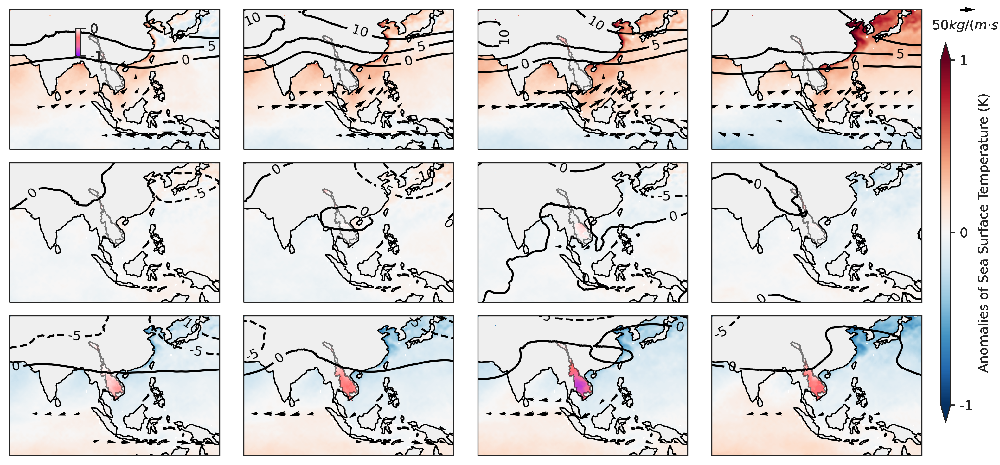

In [158]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs

lon_r = np.linspace(93.75, 108.75, 61)
lat_r = np.linspace(33.75, 8.5, 102)

lon = np.linspace(60, 150, 361)
lat = np.linspace(45, -15, 241)
g = 9.8
fig, axes = plt.subplots(nrows=3,ncols=4,figsize=(10,5),dpi=300,subplot_kw={'projection': ccrs.PlateCarree()})
ssstt = [sst_lag20,sst_lag10,sst_onset0,sst_after10,sst_lag21,sst_lag11,sst_onset1,sst_after11,sst_lag22,sst_lag12,sst_onset2,sst_after12,]
gphhh = [gph_lag20/g,gph_lag10/g,gph_onset0/g,gph_after10/g,gph_lag21/g,gph_lag11/g,gph_onset1/g,gph_after11/g,gph_lag22/g,gph_lag12/g,gph_onset2/g,gph_after12/g,]
efff = [ef_lag20,ef_lag10,ef_onset0,ef_after10,ef_lag21,ef_lag11,ef_onset1,ef_after11,ef_lag22,ef_lag12,ef_onset2,ef_after12,]
nfff = [nf_lag20,nf_lag10,nf_onset0,nf_after10,nf_lag21,nf_lag11,nf_onset1,nf_after11,nf_lag22,nf_lag12,nf_onset2,nf_after12,]
cluster_spei_0 = [spei_lag20,spei_lag10,spei0_0,spei_after10,spei_lag21,spei_lag11,spei1_0,spei_after11,spei_lag22,spei_lag12,spei2_0,spei_after12,]
clist=['#000000','#000000','#000000']
newcmp = LinearSegmentedColormap.from_list('chaos',clist)
for i, (ax,sstt,gphh,eff,nff,spei_00) in enumerate(zip(axes.flat,ssstt,gphhh,efff,nfff,cluster_spei_0)):
    projection = ccrs.PlateCarree()
    uv = np.sqrt(eff**2+nff**2)
    uv_masked = np.ma.masked_array(uv)
    uv_masked[uv_masked<20] = np.ma.masked

    extent = [60, 150, -11.011, 35.384]
    ax.set_extent(extent)
    ax.coastlines()

    im_sst = ax.imshow(sstt, extent=[60, 150, -15, 45], transform=projection,
                   vmin=-1,vmax=1, cmap='RdBu_r')
    
    cax = fig.add_axes([1.0, 0.10, 0.01, 0.8]) 
    cbar_sst = plt.colorbar(im_sst, cax=cax, extend='both')
    cbar_sst.set_label('Anomalies of Sea Surface Temperature (K)')
    cbar_sst.set_ticks([-1,0,1,])
    cbar_sst.set_ticklabels(['-1','0','1'])
    
    im_spei = ax.imshow(spei_00, extent=[93.75, 108.75, 8.5, 33.75], transform=projection,
                 vmin=-1,vmax=1, cmap=cmap7.reversed())
    im_spei.set_clim(vmin=-1, vmax=0)
    cax = fig.add_axes([0.09, 0.87, 0.005, 0.06]) 
    cbar_spei = plt.colorbar(im_spei, cax=cax, extend='min')
    # cbar_spei.set_label('SPEI')
    cbar_spei.set_ticks([-1,0])
    cbar_spei.set_ticklabels(['-1','0',])
    
    ax.add_feature(cfeature.LAND, facecolor='#efefef',)
    gaps = 24
    Q = ax.quiver(lon[::gaps], lat[::gaps], eff[::gaps,::gaps], nff[::gaps,::gaps],
                  uv_masked[::gaps,::gaps],width=0.01,scale=700, cmap=newcmp,
                  headwidth=2.5)
    qk = ax.quiverkey(Q, 1.028, 0.97, 50,  r'$50 kg/(m·s)$', labelpos='S',
                   coordinates='figure')
    CL = ax.contour(lon, lat, gphh, colors='k',transform=ccrs.PlateCarree(),
                    levels=np.arange(-10,11,5),ls='dotted')
    ax.clabel(CL,fontsize=10,fmt='%.0f')
    ax = stack_shp(ax,shp,facecolor='None',edgecolor='k',linewidth=0.75,alpha=0.5)
plt.tight_layout()
# plt.savefig('dry_mete.pdf')
plt.show()


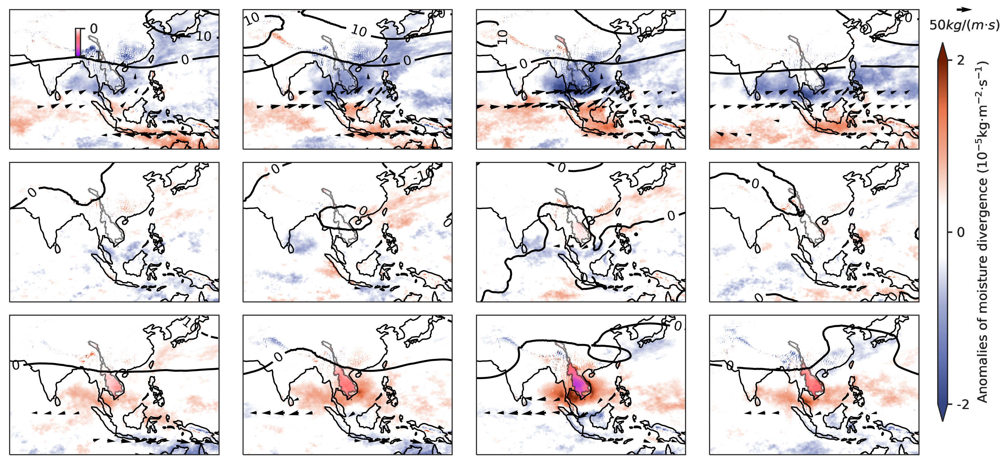

In [159]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs

lon_r = np.linspace(93.75, 108.75, 61)
lat_r = np.linspace(33.75, 8.5, 102)

lon = np.linspace(60, 150, 361)
lat = np.linspace(45, -15, 241)
g = 9.8
fig, axes = plt.subplots(nrows=3,ncols=4,figsize=(10,5),dpi=300,subplot_kw={'projection': ccrs.PlateCarree()})
mosd = [mosdiv_lag20,mosdiv_lag10,mosdiv_onset0,mosdiv_after10,mosdiv_lag21,mosdiv_lag11,mosdiv_onset1,mosdiv_after11,mosdiv_lag22,mosdiv_lag12,mosdiv_onset2,mosdiv_after12,]
gphhh = [gph_lag20/g,gph_lag10/g,gph_onset0/g,gph_after10/g,gph_lag21/g,gph_lag11/g,gph_onset1/g,gph_after11/g,gph_lag22/g,gph_lag12/g,gph_onset2/g,gph_after12/g,]
efff = [ef_lag20,ef_lag10,ef_onset0,ef_after10,ef_lag21,ef_lag11,ef_onset1,ef_after11,ef_lag22,ef_lag12,ef_onset2,ef_after12,]
nfff = [nf_lag20,nf_lag10,nf_onset0,nf_after10,nf_lag21,nf_lag11,nf_onset1,nf_after11,nf_lag22,nf_lag12,nf_onset2,nf_after12,]
cluster_spei_0 = [spei_lag20,spei_lag10,spei0_0,spei_after10,spei_lag21,spei_lag11,spei1_0,spei_after11,spei_lag22,spei_lag12,spei2_0,spei_after12,]
clist=['#000000','#000000','#000000']
newcmp = LinearSegmentedColormap.from_list('chaos',clist)
for i, (ax,mosdd,gphh,eff,nff,spei_00) in enumerate(zip(axes.flat,mosd,gphhh,efff,nfff,cluster_spei_0)):
    projection = ccrs.PlateCarree()
    uv = np.sqrt(eff**2+nff**2)
    uv_masked = np.ma.masked_array(uv)
    uv_masked[uv_masked<20] = np.ma.masked

    extent = [60, 150, -11.011, 35.384]
    ax.set_extent(extent)
    ax.coastlines()
    
    im_mosd = ax.imshow(mosdd, extent=[60, 150, -15, 45], transform=projection,
                   vmin=-0.00002,vmax=0.00002, cmap=cmap8)
    
    cax = fig.add_axes([1.0, 0.10, 0.01, 0.8]) 
    cbar_mosd = plt.colorbar(im_mosd, cax=cax, extend='both')
    cbar_mosd.set_label('Anomalies of moisture divergence (10$^{-5}$kg·m$^{-2}$·s$^{-1}$)')
    cbar_mosd.set_ticks([-0.00002,0,0.00002,])
    cbar_mosd.set_ticklabels(['-2','0','2'])
    
    im_spei = ax.imshow(spei_00, extent=[93.75, 108.75, 8.5, 33.75], transform=projection,
                 vmin=-1,vmax=1, cmap=cmap7.reversed())
    im_spei.set_clim(vmin=-1, vmax=0)
    cax = fig.add_axes([0.09, 0.87, 0.005, 0.06]) 
    cbar_spei = plt.colorbar(im_spei, cax=cax, extend='min')
    # cbar_spei.set_label('SPEI')
    cbar_spei.set_ticks([-1,0])
    cbar_spei.set_ticklabels(['-1','0',])
    
    ax.add_feature(cfeature.LAND, facecolor='#efefef',)
    gaps = 24
    Q = ax.quiver(lon[::gaps], lat[::gaps], eff[::gaps,::gaps], nff[::gaps,::gaps],
                  uv_masked[::gaps,::gaps],width=0.01,scale=700, cmap=newcmp,
                  headwidth=2.5)
    qk = ax.quiverkey(Q, 1.028, 0.97, 50,  r'$50 kg/(m·s)$', labelpos='S',
                   coordinates='figure')
    CL = ax.contour(lon, lat, gphh, colors='k',transform=ccrs.PlateCarree(),
                    levels=np.arange(-20,21,10),ls='dotted')
    ax.clabel(CL,fontsize=10,fmt='%.0f')
    ax = stack_shp(ax,shp,facecolor='None',edgecolor='k',linewidth=0.75,alpha=0.5)
plt.tight_layout()
plt.show()

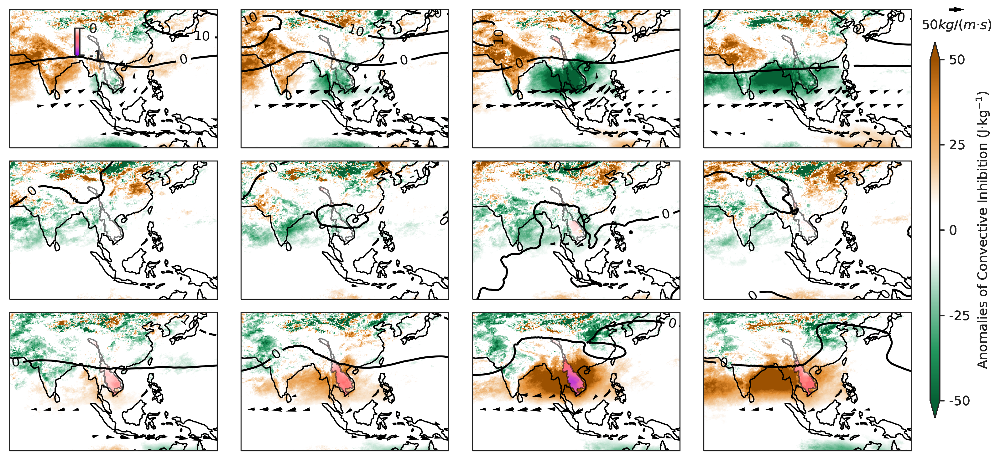

In [160]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs

lon_r = np.linspace(93.75, 108.75, 61)
lat_r = np.linspace(33.75, 8.5, 102)

lon = np.linspace(60, 150, 361)
lat = np.linspace(45, -15, 241)
g = 9.8
fig, axes = plt.subplots(nrows=3,ncols=4,figsize=(10,5),dpi=300,subplot_kw={'projection': ccrs.PlateCarree()})
cinn = [cin_lag20,cin_lag10,cin_onset0,cin_after10,cin_lag21,cin_lag11,cin_onset1,cin_after11,cin_lag22,cin_lag12,cin_onset2,cin_after12,]
gphhh = [gph_lag20/g,gph_lag10/g,gph_onset0/g,gph_after10/g,gph_lag21/g,gph_lag11/g,gph_onset1/g,gph_after11/g,gph_lag22/g,gph_lag12/g,gph_onset2/g,gph_after12/g,]
efff = [ef_lag20,ef_lag10,ef_onset0,ef_after10,ef_lag21,ef_lag11,ef_onset1,ef_after11,ef_lag22,ef_lag12,ef_onset2,ef_after12,]
nfff = [nf_lag20,nf_lag10,nf_onset0,nf_after10,nf_lag21,nf_lag11,nf_onset1,nf_after11,nf_lag22,nf_lag12,nf_onset2,nf_after12,]
cluster_spei_0 = [spei_lag20,spei_lag10,spei0_0,spei_after10,spei_lag21,spei_lag11,spei1_0,spei_after11,spei_lag22,spei_lag12,spei2_0,spei_after12,]
clist=['#000000','#000000','#000000']
newcmp = LinearSegmentedColormap.from_list('chaos',clist)
for i, (ax,cinnn,gphh,eff,nff,spei_00) in enumerate(zip(axes.flat,cinn,gphhh,efff,nfff,cluster_spei_0)):
    projection = ccrs.PlateCarree()
    uv = np.sqrt(eff**2+nff**2)
    uv_masked = np.ma.masked_array(uv)
    uv_masked[uv_masked<20] = np.ma.masked

    extent = [60, 150, -11.011, 35.384]
    ax.set_extent(extent)
    ax.coastlines()
    
    
    im_cinn = ax.imshow(cinnn, extent=[60, 150, -15, 45], transform=projection,
                   vmin=-50,vmax=50, cmap= cmap9.reversed())#'RdBu_r')
    
    cax = fig.add_axes([1.0, 0.10, 0.01, 0.8]) 
    cbar_cinn = plt.colorbar(im_cinn, cax=cax, extend='both')
    cbar_cinn.set_label('Anomalies of Convective Inhibition (J·kg$^{-1}$)')
    cbar_cinn.set_ticks([-50,-25,0,25,50])
    cbar_cinn.set_ticklabels(['-50','-25','0','25','50'])
    
    im_spei = ax.imshow(spei_00, extent=[93.75, 108.75, 8.5, 33.75], transform=projection,
                 vmin=-1,vmax=1, cmap=cmap7.reversed())
    im_spei.set_clim(vmin=-1, vmax=0)
    cax = fig.add_axes([0.09, 0.87, 0.005, 0.06]) 
    cbar_spei = plt.colorbar(im_spei, cax=cax, extend='min')
    # cbar_spei.set_label('SPEI')
    cbar_spei.set_ticks([-1,0])
    cbar_spei.set_ticklabels(['-1','0',])
    
    ax.add_feature(cfeature.LAND, facecolor='#efefef',)
    gaps = 24
    Q = ax.quiver(lon[::gaps], lat[::gaps], eff[::gaps,::gaps], nff[::gaps,::gaps],
                  uv_masked[::gaps,::gaps],width=0.01,scale=700, cmap=newcmp,
                  headwidth=2.5)
    qk = ax.quiverkey(Q, 1.028, 0.97, 50,  r'$50 kg/(m·s)$', labelpos='S',
                   coordinates='figure')
    CL = ax.contour(lon, lat, gphh, colors='k',transform=ccrs.PlateCarree(),
                    levels=np.arange(-20,21,10),ls='dotted')
    ax.clabel(CL,fontsize=10,fmt='%.0f')
    ax = stack_shp(ax,shp,facecolor='None',edgecolor='k',linewidth=0.75,alpha=0.5)
plt.tight_layout()
plt.show()

In [161]:
cluster_year = df['pred_result'].values.reshape(63,26)
cluster_week = cluster_year.transpose(1,0)

clu_we = []
for i in range(0,26):
    for j in range(0,3):
        clu_we.append(np.count_nonzero(cluster_week[i]==j))

clu_we = np.array(clu_we).reshape(26,3).transpose(1,0)

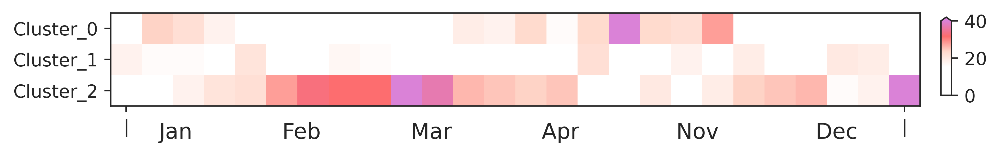

In [162]:
clist6=['#ffffff','#ffffff','#ffd9cc','#fe6d6d','#da82d7']
cmap6 = LinearSegmentedColormap.from_list('chaos',clist6)

fig, ax = plt.subplots( figsize=(8,5), dpi=500)
im = ax.imshow(clu_we, cmap=cmap6,vmax=40)
cax = fig.add_axes([0.92, 0.44, 0.01, 0.12])
cbar = plt.colorbar(im, cax=cax, extend='max')
cbar.set_ticks([0,20,40])
cbar.set_ticklabels(['0','20','40',])


ax.set_yticks([0,1,2])  
ax.set_yticklabels(['Cluster_0', 'Cluster_1','Cluster_2'])  
ax.set_xticks([0,25])  
ax.set_xticklabels(['|', '|'])  
ax.text(0.923, -0.17, 'Jan             Feb             Mar             Apr              Nov              Dec', 
        ha='right', va='top',fontsize=12, transform=ax.transAxes)
plt.show()

In [163]:
clu_ye = []
for i in range(0,63):
    for j in range(0,3):
        clu_ye.append(np.count_nonzero(cluster_year[i]==j))
clu_ye = np.array(clu_ye).reshape(63,3)

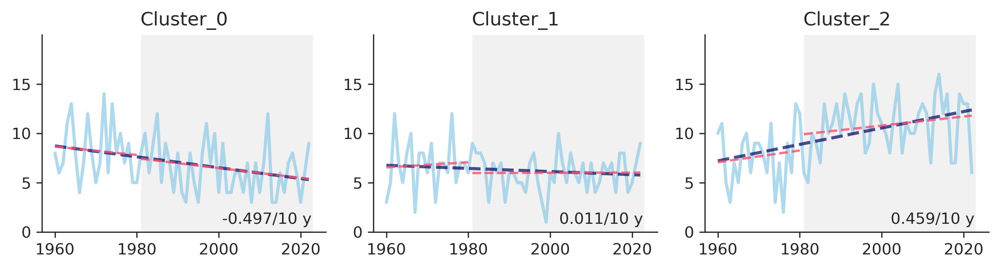

In [164]:
import matplotlib.pyplot as plt
from matplotlib.ticker import PercentFormatter

clu_year = [clu_ye[:,0],clu_ye[:,1],clu_ye[:,2]]
namess = ['Cluster_0', 'Cluster_1', 'Cluster_2']
x = np.arange(63)
x1 = np.arange(0,21)
x2 = np.arange(21,63)
fig, axes = plt.subplots(1, 3, figsize=(9, 2.5), dpi=300)

for i, ax in enumerate(axes.flat):
    slope, intercept, r_value, p_value, std_err = linregress(x, clu_year[i])
    slope1, intercept1, r_value1, p_value1, std_err1 = linregress(x1, clu_year[i][0:21])
    slope2, intercept2, r_value2, p_value2, std_err2 = linregress(x2, clu_year[i][21:63])
    ax.plot(clu_year[i],color="#8ecae6",lw=2,alpha=0.7)
    ax.set_title(namess[i])
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.set_xticks([0, 20, 40, 60])  
    ax.set_xticklabels(['1960',  '1980', '2000', '2020'])  
    ax.set_yticks([0,5,10,15])  
    ax.set_yticklabels(['0','5','10','15'])  
    ax.plot(x, intercept + slope * x, color='#03045e', linestyle='--',lw= 2,alpha=0.7)
    ax.plot(x1, intercept1 + slope1 * x1, color='#ff4d6d', linestyle='--',lw= 1.5,alpha=0.8)
    ax.plot(x2, intercept2 + slope2 * x2, color='#ff4d6d', linestyle='--',lw= 1.5,alpha=0.8)
    ax.axvspan(21, 63, facecolor='lightgray', alpha=0.3)
    ax.set_ylim(0, 20)
    ax.text(0.95, 0.1, f'{slope2*10:.3f}/10 y', ha='right', va='top', transform=ax.transAxes)
    ax.xaxis.set_ticks_position('bottom')  
    ax.yaxis.set_ticks_position('left') 
    if p_value2 < 0.05:
        ax.text(0.90, 0.95, f'p = {p_value2:.3f}', ha='right', va='top', transform=ax.transAxes)

        
plt.tight_layout()
plt.show()

# Quantify the change process of moisture divergence and CIN

In [165]:
cinn = [cin_lag20,cin_lag10,cin_onset0,cin_after10,cin_lag21,cin_lag11,cin_onset1,cin_after11,cin_lag22,cin_lag12,cin_onset2,cin_after12,]
mosd = [mosdiv_lag20,mosdiv_lag10,mosdiv_onset0,mosdiv_after10,mosdiv_lag21,mosdiv_lag11,mosdiv_onset1,mosdiv_after11,mosdiv_lag22,mosdiv_lag12,mosdiv_onset2,mosdiv_after12,]

In [166]:
cin_lag20.shape

(241, 361)

In [167]:
cinn_arr = np.array(cinn)# +cin_m
ds_cinn = xr.Dataset({'cin': (['cluster','lat', 'lon'], cinn_arr)},
                    coords={'cluster': (['cluster'], np.arange(0,12)),
                            'lon': (['lon'],ds_cin.lon.values),
                            'lat': (['lat'],ds_cin.lat.values)})

ds_cinnm = xr.Dataset({'cin': (['lat', 'lon'], cin_m)},
                    coords={'lon': (['lon'],ds_cin.lon.values),
                            'lat': (['lat'],ds_cin.lat.values)})


ds_cin_mk,_ = ncslice(ds_cinn,shp,18,index='LEGEND')
ds_cinm_mk,_ = ncslice(ds_cinnm,shp,18,index='LEGEND')
cin_bar = ds_cin_mk.cin.values
cin_bar_m = ds_cinm_mk.cin.values
for i in range(0,3):
    mask = ~np.isnan(names['spei'+str(i)+'_0'])
    names['cinbar'+str(i)]=np.empty_like(cin_bar[i*4:(i+1)*4], dtype=float)
    names['cinbar'+str(i)].fill(np.nan)
    names['cinbar'+str(i)][:,mask] = cin_bar[i*4:(i+1)*4][:,mask]

    names['cinbar_m'+str(i)]=np.empty_like(cin_bar_m, dtype=float)
    names['cinbar_m'+str(i)].fill(np.nan)
    names['cinbar_m'+str(i)][mask] = cin_bar_m[mask]



In [168]:
df_cin = pd.DataFrame(columns=['cinbar', 'values'])
for i in range(0,3):
    names['df_cin'+str(i)] = pd.DataFrame(columns=['cinbar', 'values'])
    
    for j in range(0,4):
        names['cinbar'+str(i)+str(j)] = names['cinbar'+str(i)][j]
        names['cinbar'+str(i)+str(j)] = names['cinbar'+str(i)+str(j)][~np.isnan(names['cinbar'+str(i)+str(j)])]
        names['df_cin'+str(i)] = pd.concat([names['df_cin'+str(i)], pd.DataFrame({'cinbar': ['lag'+str(i)+str(j)] * len(names['cinbar'+str(i)+str(j)]), 
                                              'values': names['cinbar'+str(i)+str(j)]})])

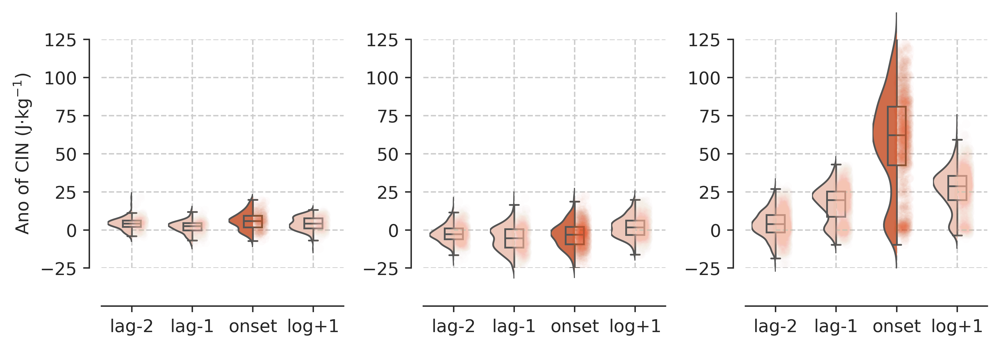

In [175]:
import matplotlib.pyplot as plt
import seaborn as sns

cin_palette = ["#f5c4b3", "#f5c4b3", "#e56134", "#f5c4b3",]
sns.set_palette(cin_palette)
palette = cin_palette
sns.set_style('white')

df_data = [df_cin0, df_cin1, df_cin2]
fig, axes = plt.subplots(1, 3, figsize=(8, 3), dpi=500)  # 创建一个包含3个子图的画布，比例为1:3

for i, ax in enumerate(axes):
    sns.violinplot(x="cinbar", y="values", data=df_data[i], hue="cinbar", dodge=False,
                   palette=palette, scale="area", inner=None, ax=ax, linewidth=1)  # 调整scale参数为"area"
    
    sns.set_style('ticks')
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()
    for violin in ax.collections:
        bbox = violin.get_paths()[0].get_extents()
        x0, y0, width, height = bbox.bounds
        violin.set_clip_path(plt.Rectangle((x0, y0), width / 2, height, transform=ax.transData))

    sns.boxplot(x="cinbar", y="values", data=df_data[i], saturation=1, showfliers=False,
                width=0.3, boxprops={'zorder': 3, 'facecolor': 'none'}, ax=ax, linewidth=1)
    old_len_collections = len(ax.collections)
    # ax.axhline(y=cinbar_m_clu[i], color='#5a189a', linestyle='--', linewidth=2)
    sns.stripplot(x="cinbar", y="values", data=df_data[i], hue="cinbar", palette=palette, dodge=False, ax=ax, alpha=0.02)
    for dots in ax.collections[old_len_collections:]:
        dots.set_offsets(dots.get_offsets() + np.array([0.12, 0]))
    ax.set_xlim(-0.5,3.5)
    ax.set_ylim(-25,125)
    ax.tick_params(left=True,bottom=True) 
    #ax.set_yticks([0,0.5,1,1.5,2])
    ax.set_xticklabels(['lag-2', 'lag-1', 'onset', 'log+1'])
    ax.legend_.remove()
    # ax.axhline(y=cinbar_m_clu[i], color='#5a189a', linestyle='--', linewidth=2)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_position(('data', -0.7))
    ax.spines['bottom'].set_position(('data', -50))
    ax.set_ylabel('Ano of CIN (J·kg$^{-1}$)')
    ax.set_xlabel('')
    ax.grid(ls='--')
    if i != 0:
        ax.set_ylabel('')
plt.tight_layout()
plt.savefig('Fig_save/CIN_dry_dots.pdf')
plt.show()

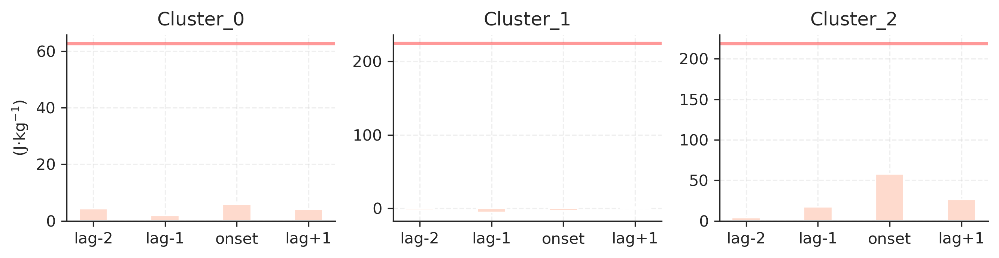

In [170]:
import matplotlib.pyplot as plt
from matplotlib.ticker import PercentFormatter

cinbar_clu = [np.nanmean(cinbar0,axis=(1,2)),np.nanmean(cinbar1,axis=(1,2)),np.nanmean(cinbar2,axis=(1,2))]
cinbar_m_clu = [np.nanmean(cinbar_m0),np.nanmean(cinbar_m1),np.nanmean(cinbar_m2)]
namess = ['Cluster_0', 'Cluster_1', 'Cluster_2']
x_label = ['lag-2','lag-1','onset','lag+1']
fig, axes = plt.subplots(1, 3, figsize=(9, 2.4), dpi=300)

for i, ax in enumerate(axes.flat):
    ax.set_title(namess[i])
    ax.grid(ls='--',alpha=0.3)
    ax.bar(x_label,cinbar_clu[i],color="#fedacd",width=0.4)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.axhline(y=cinbar_m_clu[i], color='red', ls='-', lw=2, label='Average',alpha=0.4)
    if i == 0:
        ax.set_ylabel('(J·kg$^{-1}$)')
plt.tight_layout()
plt.show()

In [171]:
mosd_arr = np.array(mosd)#+mosdiv_m
ds_mosdivv = xr.Dataset({'p84.162': (['cluster','lat', 'lon'], mosd_arr)},
                    coords={'cluster': (['cluster'], np.arange(0,12)),
                            'lon': (['lon'],ds_mosdiv.lon.values),
                            'lat': (['lat'],ds_mosdiv.lat.values)})

ds_mosdivvm = xr.Dataset({'p84.162': (['lat', 'lon'], mosdiv_m)},
                    coords={'lon': (['lon'],ds_mosdiv.lon.values),
                            'lat': (['lat'],ds_mosdiv.lat.values)})

ds_mosdivv_mk,_ = ncslice(ds_mosdivv,shp,18,index='LEGEND')
ds_mosdivvm_mk,_ = ncslice(ds_mosdivvm,shp,18,index='LEGEND')
mosdiv_bar = ds_mosdivv_mk['p84.162'].values
mosdiv_bar_m = ds_mosdivvm_mk['p84.162'].values


for i in range(0,3):
    mask = ~np.isnan(names['spei'+str(i)+'_0'])
    names['mosdivbar'+str(i)]=np.empty_like(mosdiv_bar[i*4:(i+1)*4], dtype=float)
    names['mosdivbar'+str(i)].fill(np.nan)
    names['mosdivbar'+str(i)][:,mask] = mosdiv_bar[i*4:(i+1)*4][:,mask]

    names['mosdivbar_m'+str(i)]=np.empty_like(mosdiv_bar_m, dtype=float)
    names['mosdivbar_m'+str(i)].fill(np.nan)
    names['mosdivbar_m'+str(i)][mask] = mosdiv_bar_m[mask]




In [172]:
df_mosdiv = pd.DataFrame(columns=['mosdivbar', 'values'])
for i in range(0,3):
    names['df_mosdiv'+str(i)] = pd.DataFrame(columns=['cinbar', 'values'])
    
    for j in range(0,4):
        names['mosdivbar'+str(i)+str(j)] = names['mosdivbar'+str(i)][j]
        names['mosdivbar'+str(i)+str(j)] = names['mosdivbar'+str(i)+str(j)][~np.isnan(names['mosdivbar'+str(i)+str(j)])]
        names['df_mosdiv'+str(i)] = pd.concat([names['df_mosdiv'+str(i)], pd.DataFrame({'mosdivbar': ['lag'+str(i)+str(j)] * len(names['mosdivbar'+str(i)+str(j)]), 
                                              'values': names['mosdivbar'+str(i)+str(j)]})])

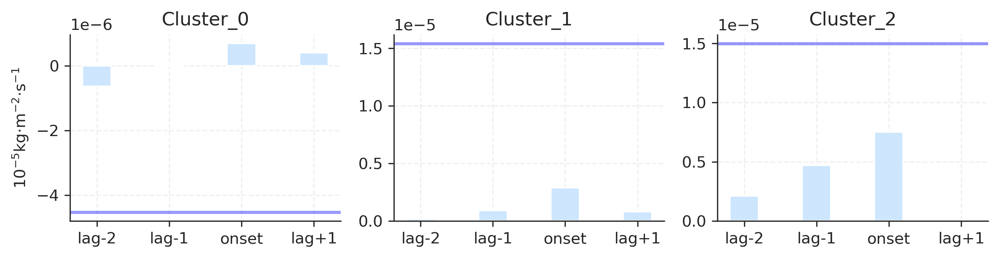

In [173]:
import matplotlib.pyplot as plt
from matplotlib.ticker import PercentFormatter

mosdivbar_clu = [np.nanmean(mosdivbar0,axis=(1,2)),np.nanmean(mosdivbar1,axis=(1,2)),np.nanmean(mosdivbar2,axis=(1,2))]
mosdivbar_m_clu = [np.nanmean(mosdivbar_m0),np.nanmean(mosdivbar_m1),np.nanmean(mosdivbar_m2)]
namess = ['Cluster_0', 'Cluster_1', 'Cluster_2']
x_label = ['lag-2','lag-1','onset','lag+1']
fig, axes = plt.subplots(1, 3, figsize=(9, 2.4), dpi=300)

for i, ax in enumerate(axes.flat):
    ax.set_title(namess[i])
    ax.grid(ls='--',alpha=0.3)
    ax.bar(x_label,mosdivbar_clu[i],color="#cde6fe",width=0.4)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.axhline(y=mosdivbar_m_clu[i], color='b', ls='-', lw=2, label='Average',alpha=0.4)
    if i == 0:
        ax.set_ylabel('10$^{-5}$kg·m$^{-2}$·s$^{-1}$')
plt.tight_layout()
plt.show()

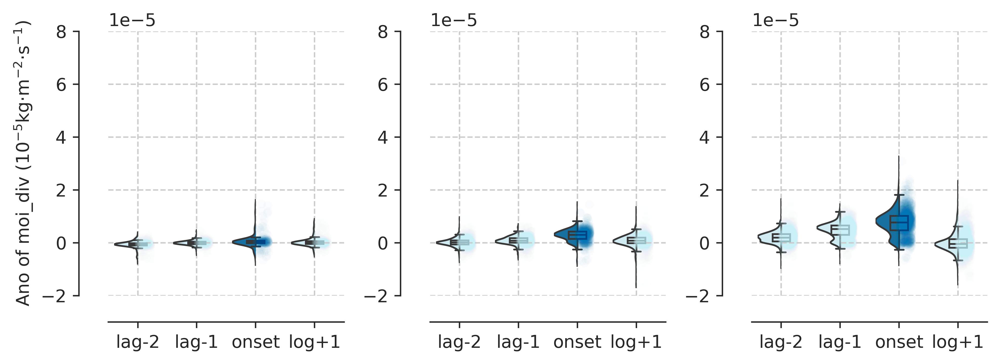

In [174]:
import matplotlib.pyplot as plt
import seaborn as sns

cin_palette = ["#caf0f8", "#caf0f8", "#0077b6", "#caf0f8",]
sns.set_palette(cin_palette)
palette = cin_palette
sns.set_style('white')

df_data = [df_mosdiv0, df_mosdiv1, df_mosdiv2]
fig, axes = plt.subplots(1, 3, figsize=(8, 3), dpi=500)  # 创建一个包含3个子图的画布，比例为1:3

for i, ax in enumerate(axes):
    sns.violinplot(x="mosdivbar", y="values", data=df_data[i], hue="mosdivbar", dodge=False,
                   palette=palette, scale="area", inner=None, ax=ax, linewidth=1)  # 调整scale参数为"area"
    sns.set_style('ticks')
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()
    for violin in ax.collections:
        bbox = violin.get_paths()[0].get_extents()
        x0, y0, width, height = bbox.bounds
        violin.set_clip_path(plt.Rectangle((x0, y0), width / 2, height, transform=ax.transData))

    sns.boxplot(x="mosdivbar", y="values", data=df_data[i], saturation=1, showfliers=False,
                width=0.3, boxprops={'zorder': 3, 'facecolor': 'none'}, ax=ax, linewidth=1)
    old_len_collections = len(ax.collections)
    # ax.axhline(y=mosdivbar_m_clu[i], color='#5a189a', linestyle='--', linewidth=2)
    sns.stripplot(x="mosdivbar", y="values", data=df_data[i], hue="mosdivbar", palette=palette, dodge=False, ax=ax, alpha=0.02)
    for dots in ax.collections[old_len_collections:]:
        dots.set_offsets(dots.get_offsets() + np.array([0.12, 0]))
    # ax.set_xlim(-0.0002,0.0002)
    ax.set_ylim(-0.00002,0.00008)
    ax.tick_params(left=True,bottom=True) 
    #ax.set_yticks([0,0.5,1,1.5,2])
    ax.legend_.remove()
    
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_position(('data', -1))
    ax.spines['bottom'].set_position(('data', -0.00003))
    ax.set_ylabel('Ano of moi_div (10$^{-5}$kg·m$^{-2}$·s$^{-1}$)')
    ax.set_xlabel('')
    ax.set_xticklabels(['lag-2', 'lag-1', 'onset', 'log+1'])
    ax.grid(ls='--')
    if i != 0:
        ax.set_ylabel('')

plt.tight_layout()
plt.savefig('Fig_save/mosd_dry_dots.pdf')
plt.show()